In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime
from datetime import timezone

from math import cos, radians

In [2]:
def plot_TMA():
    
    fig, ax = plt.subplots(1, 1,figsize=(10,10))
    
    TMA_lon=[18.2130555555556, 18.5547222222222, 18.8469444444444, 19.3136111111111, 19.8280555555556, 19.2736111111111,
          18.9683333333333, 18.7547222222222, 18.5394444444444, 18.4572222222222, 17.9327777777778, 17.4569444444444,
          17.4077777777778, 17.2233333333333, 16.7077777777778, 16.2677777777778, 16.3183333333333, 16.4466666666667,
          17.5966666666667, 18.2130555555556];

    TMA_lat=[60.2994444444444, 60.2661111111111, 59.8827777777778, 60.0352777777778, 59.6736111111111, 59.5994444444444,
          59.255, 59.0419444444444, 58.8325, 58.7525, 58.5830555555556, 58.6163888888889, 58.9661111111111,
          58.9786111111111, 59.0119444444444, 59.0494444444444, 59.3238888888889, 59.7494444444444, 60.2327777777778,
          60.2994444444444];

    number_of_rwys = 4

    rwy1_lon=[17.9361345, 17.9791531944444];
    rwy1_lat=[59.6584189166667, 59.6638971944444 ];

    rwy2_lon=[17.9132249722222, 17.9237679722222];
    rwy2_lat=[59.637256, 59.6664016944444 ];

    rwy3_lon=[17.9507426111111, 17.9587480555556];
    rwy3_lat=[59.6263963888889, 59.6484673055556];

    central_latitude = min(TMA_lat) + (max(TMA_lat)-min(TMA_lat))/2
        
    # calculate the aspect ratio that will approximate a 
    # Mercator projection at this central latitude 
    mercator_aspect_ratio = 1/cos(radians(central_latitude))

    # set the aspect ratio of the axes to that
    ax.set_aspect(mercator_aspect_ratio)
 
    plt.xlabel('Longitude', fontsize=25)
    plt.ylabel('Latitude', fontsize=25)  
    
    plt.tick_params(labelsize=15)

    
    plt.plot(TMA_lon, TMA_lat, color="blue")
    plt.plot(rwy1_lon,rwy1_lat, color="red")
    plt.plot(rwy2_lon,rwy2_lat, color="red")
    plt.plot(rwy3_lon,rwy3_lat, color="red")
    
    ELTOK_lon = 16.6503
    ELTOK_lat = 59.5861
    HMR_lon = 18.3917
    HMR_lat = 60.2794
    XILAN_lon = 19.0761
    XILAN_lat = 59.6594
    NILUG_lon = 17.8847
    NILUG_lat = 58.8158

    plt.plot(HMR_lon, HMR_lat, 'ro')
    plt.plot(NILUG_lon, NILUG_lat, 'ro')
    plt.plot(XILAN_lon, XILAN_lat, 'ro')
    plt.plot(ELTOK_lon, ELTOK_lat, 'ro')

In [3]:
 def plot_horizontal_profile(df, linewidth=1):
    
    plot_TMA()
    
    if df.empty:
        return
    
    for flight_id, flight_df in df.groupby(level='flightId'):
        #print(flight_id)
        flight_states_opensky_df = df.loc[(flight_id,), :]
        lons = flight_df["lon"]
        lats = flight_df["lat"]
        
        plt.plot(lons, lats, color='k', linewidth=linewidth)

# Data uploading

In [4]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_01_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_01_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_01_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_01_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_01_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

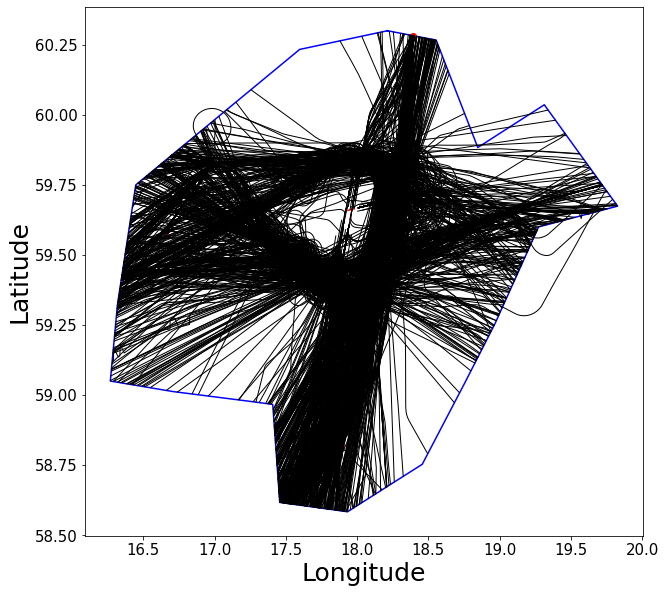

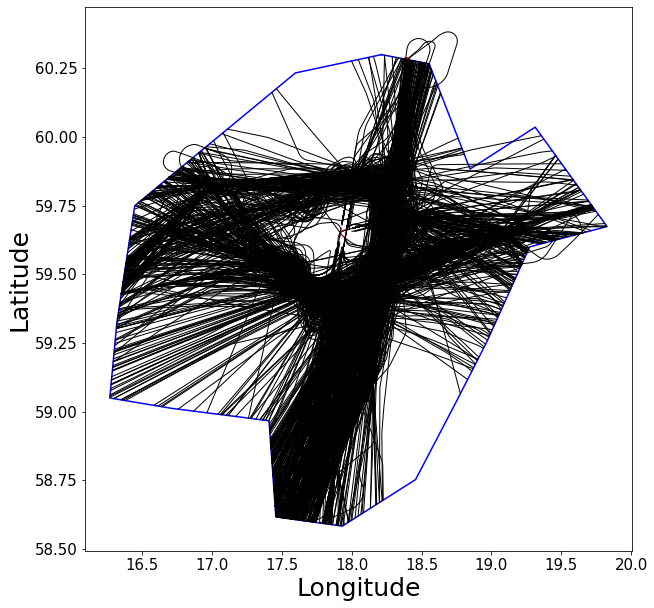

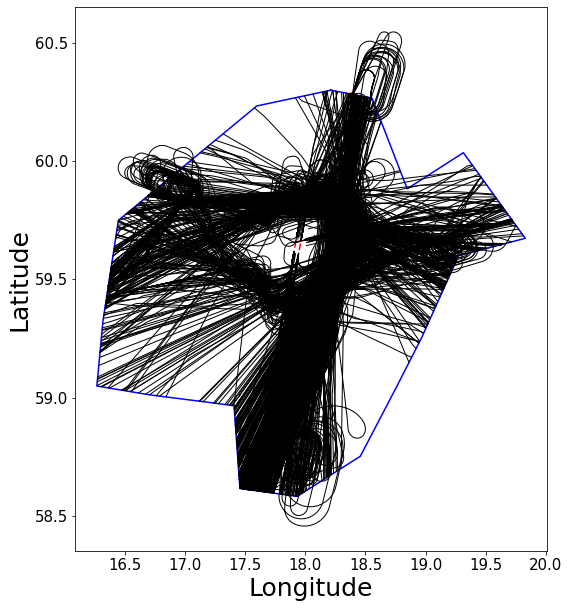

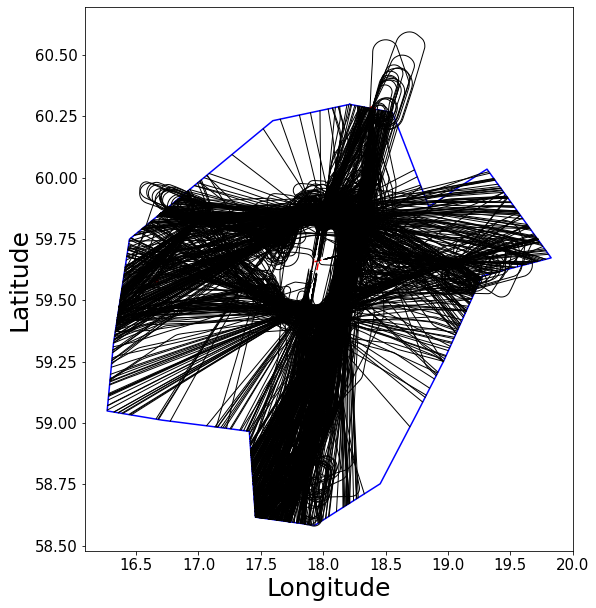

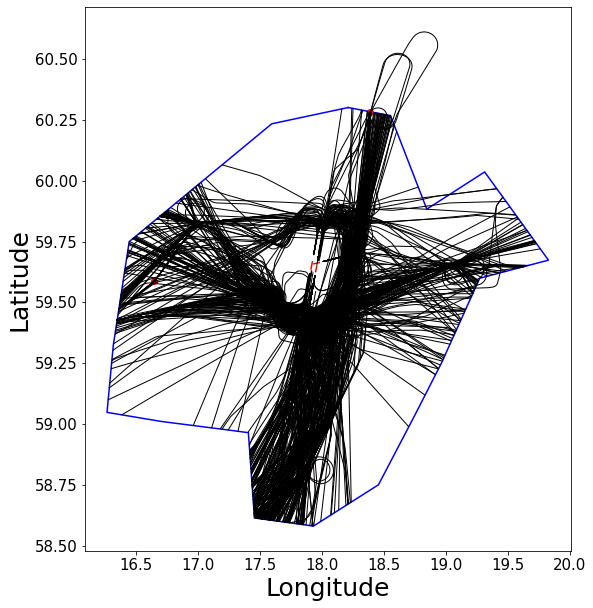

In [5]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_5.png")

In [6]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_02_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_02_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_02_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_02_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

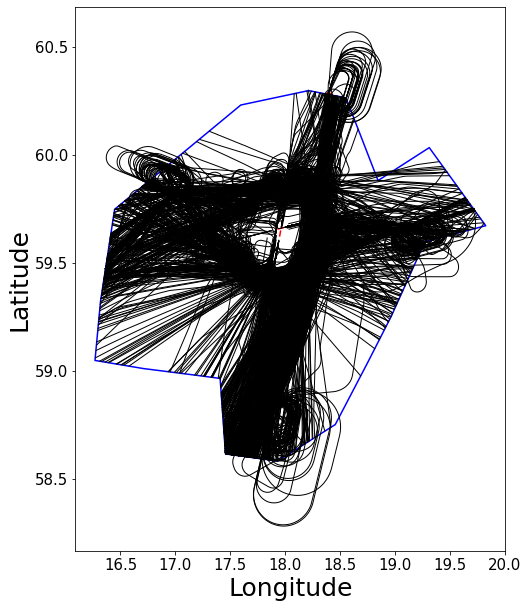

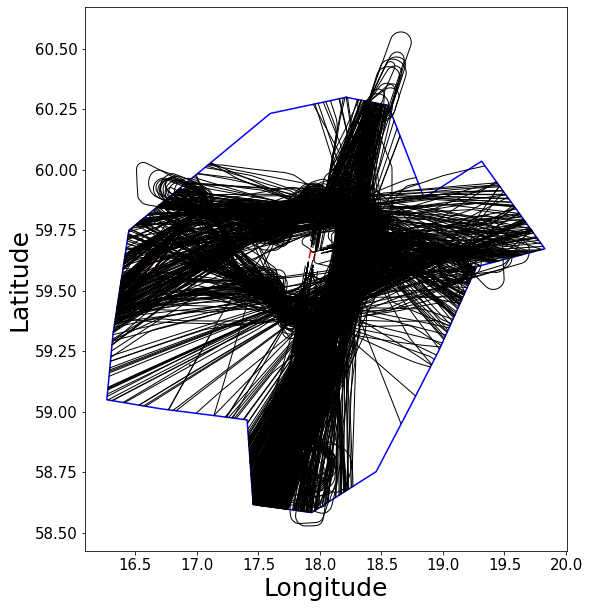

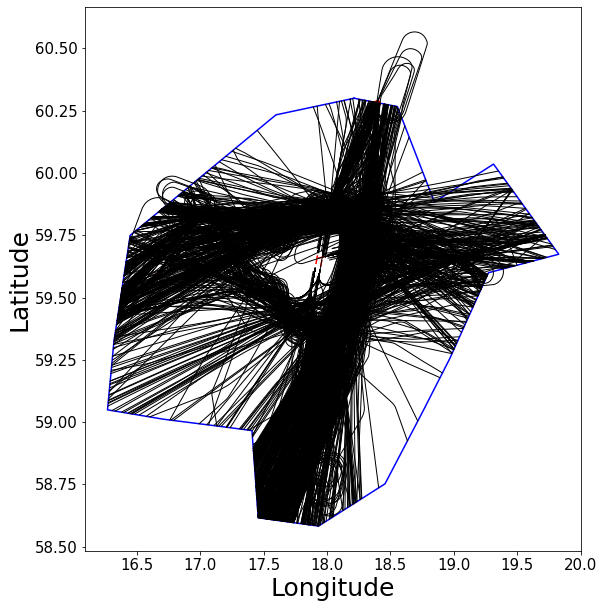

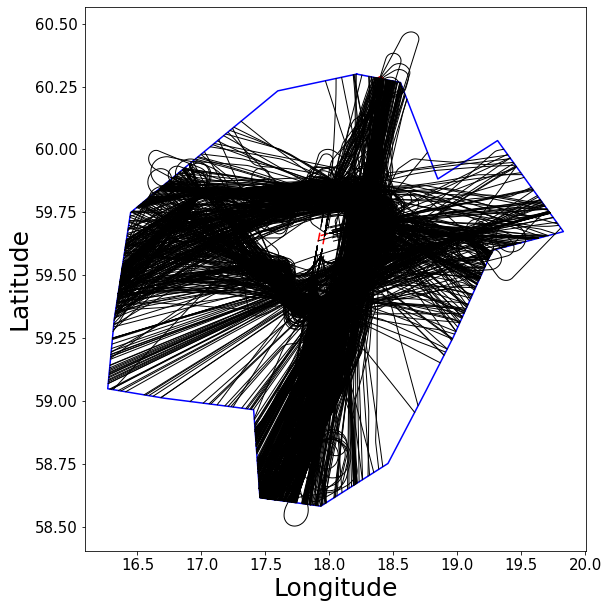

In [7]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_01_4.png")

In [8]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_03_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_03_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_03_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_03_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_03_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

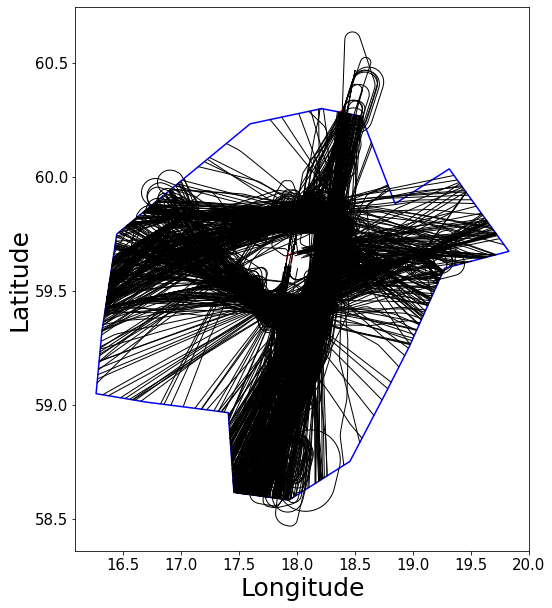

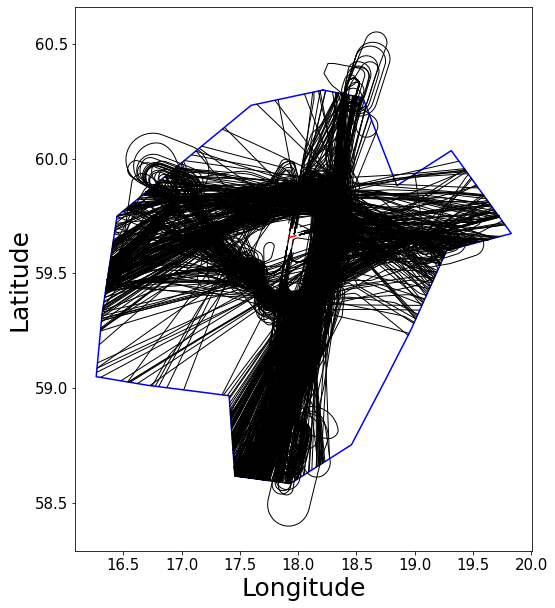

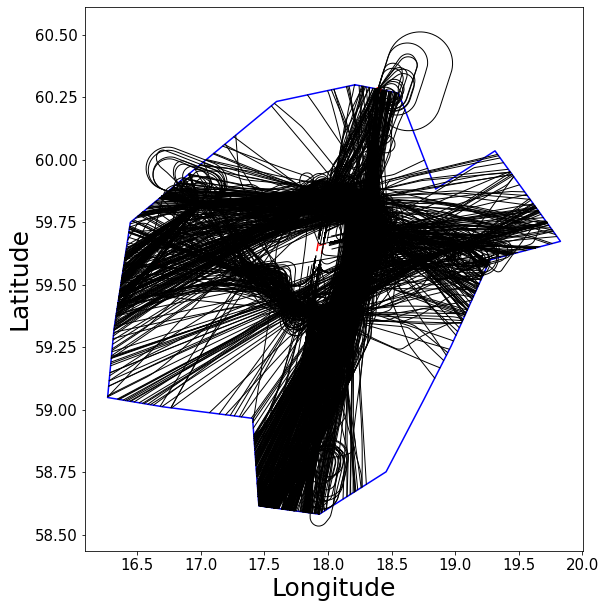

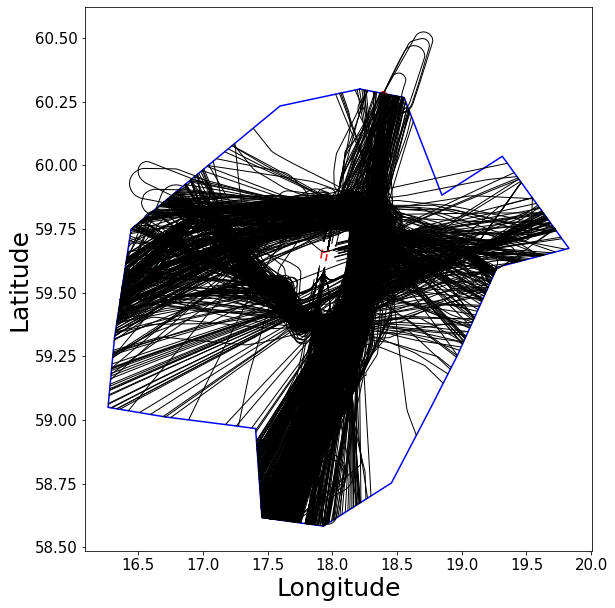

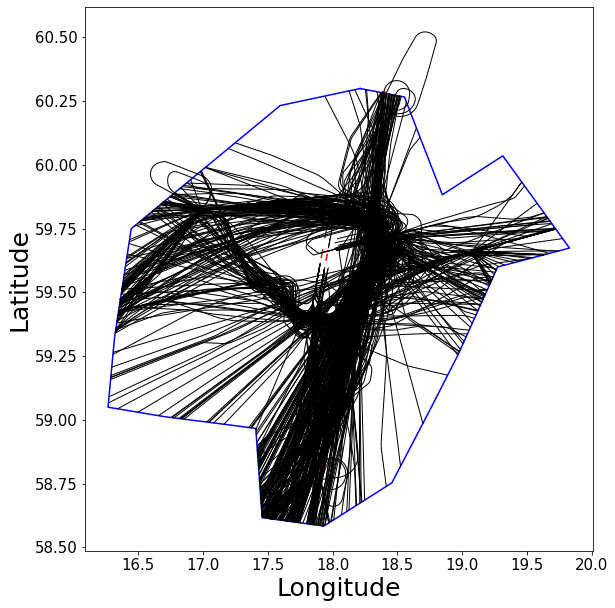

In [9]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_03_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_03_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_03_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_03_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_03_5.png")

In [10]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_04_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_04_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_04_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_04_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_04_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

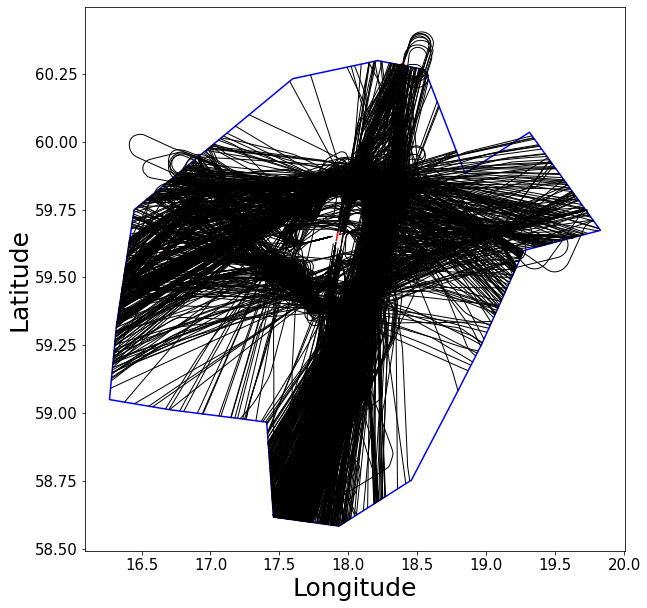

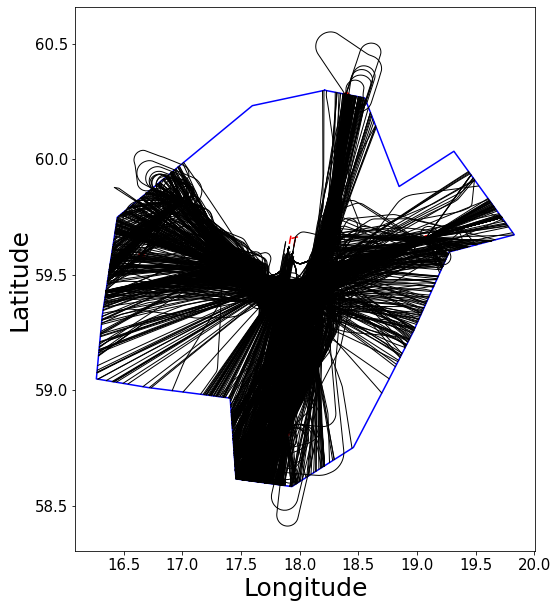

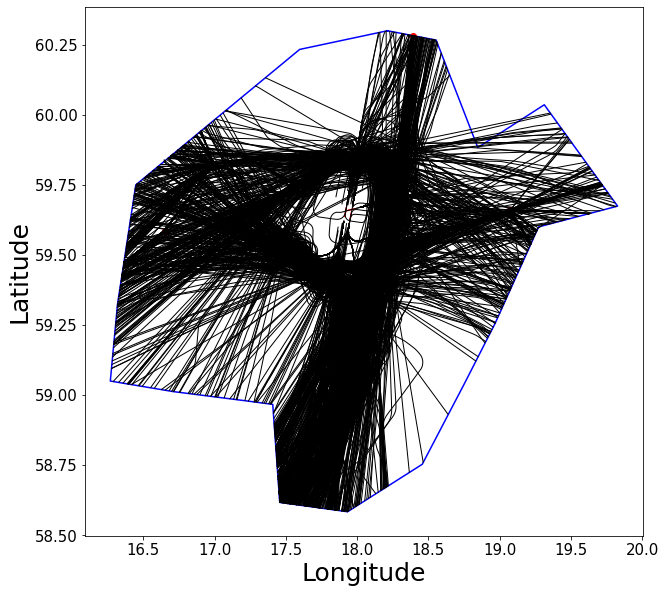

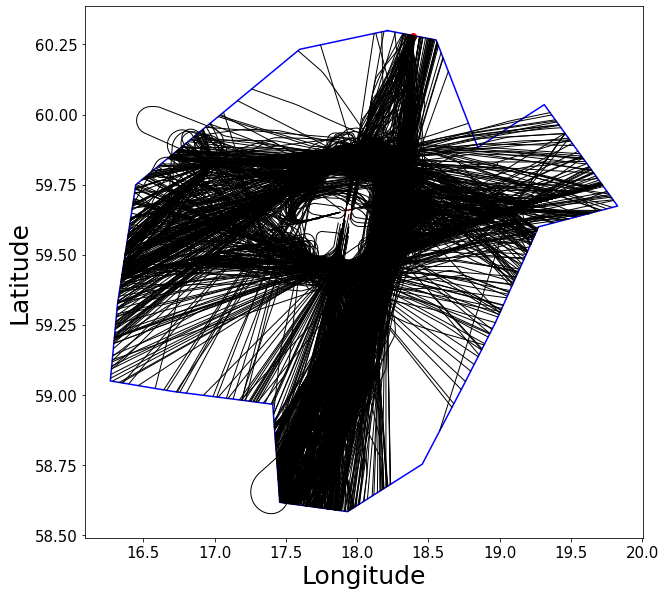

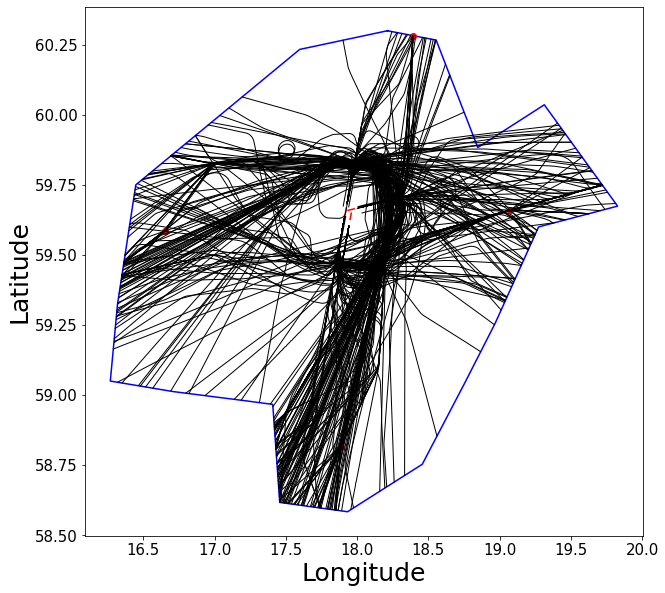

In [11]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_04_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_04_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_04_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_04_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_04_5.png")

In [12]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_05_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_05_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_05_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_05_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_05_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

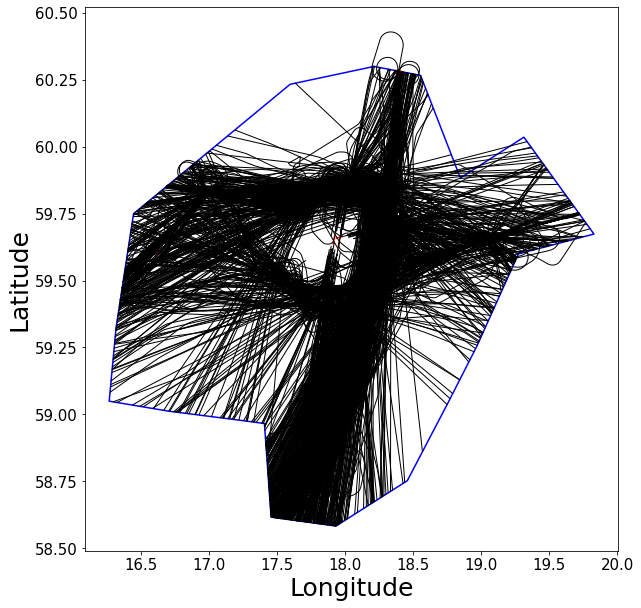

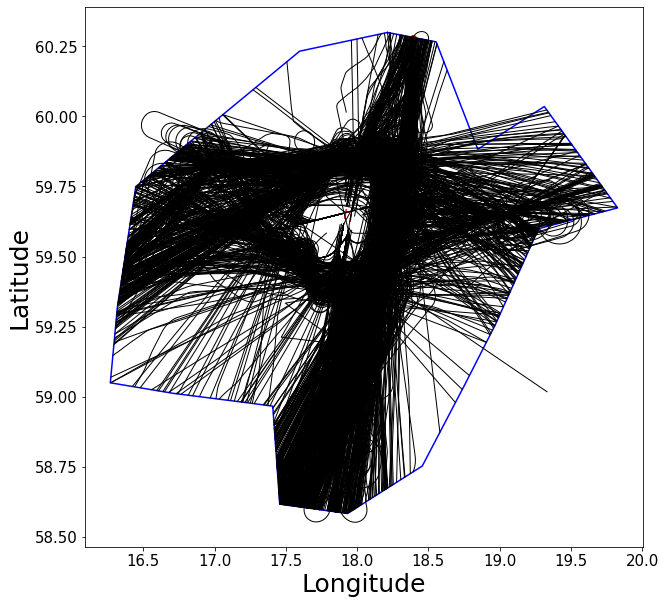

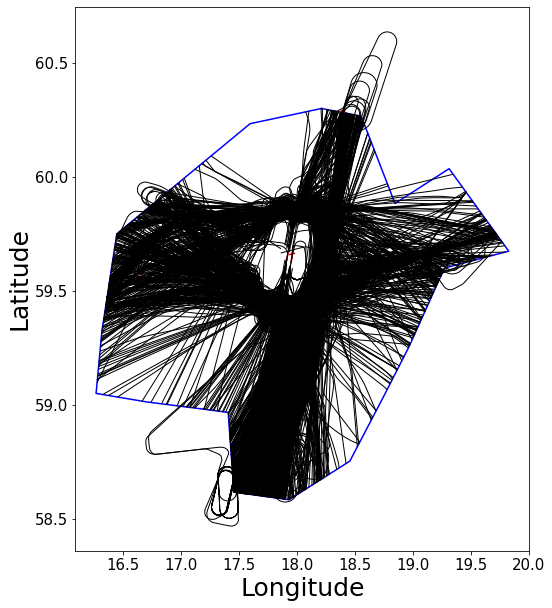

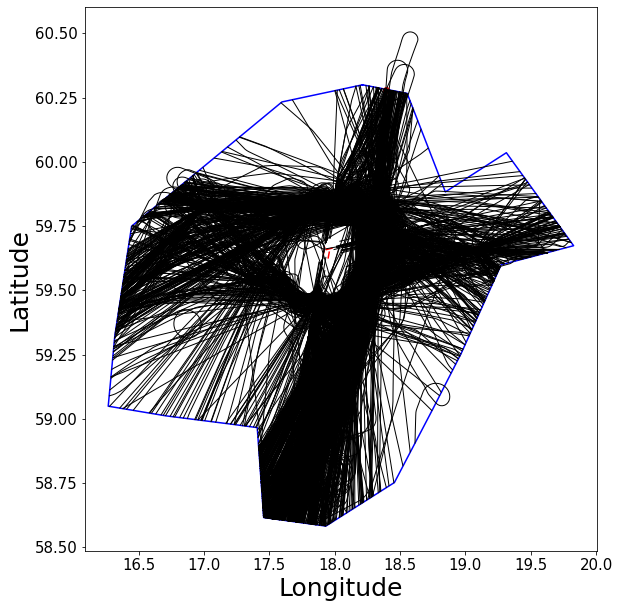

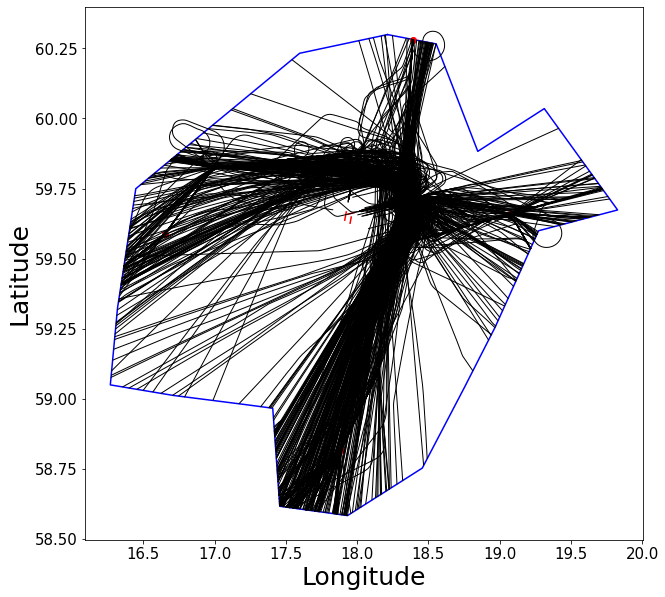

In [13]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_05_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_05_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_05_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_05_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_05_5.png")

In [14]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_06_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_06_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_06_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_06_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_06_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

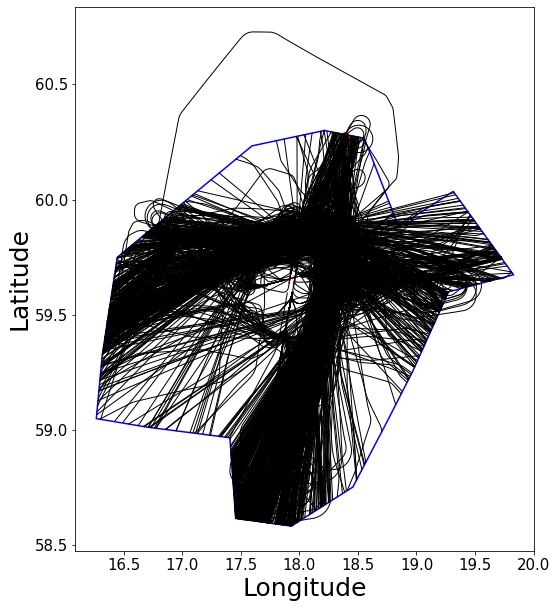

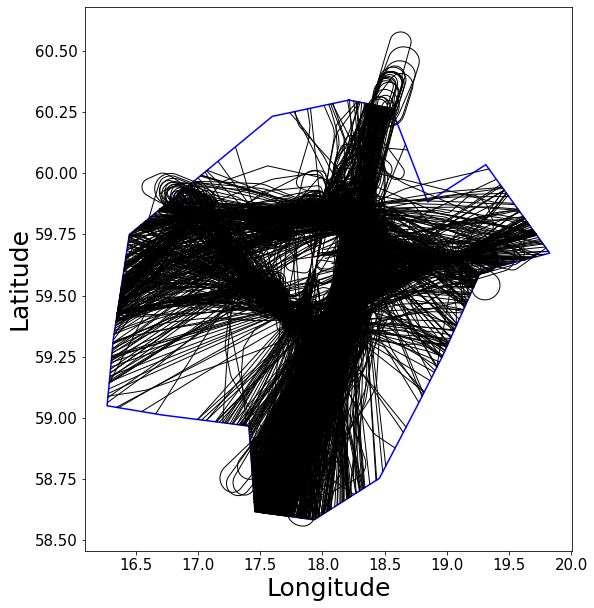

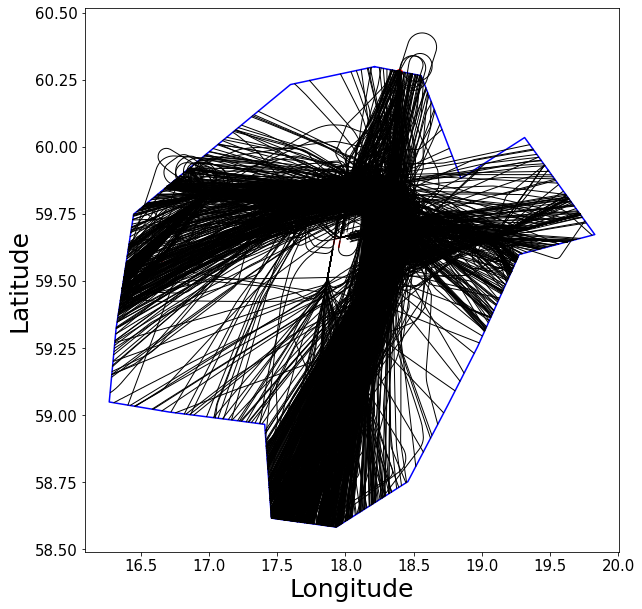

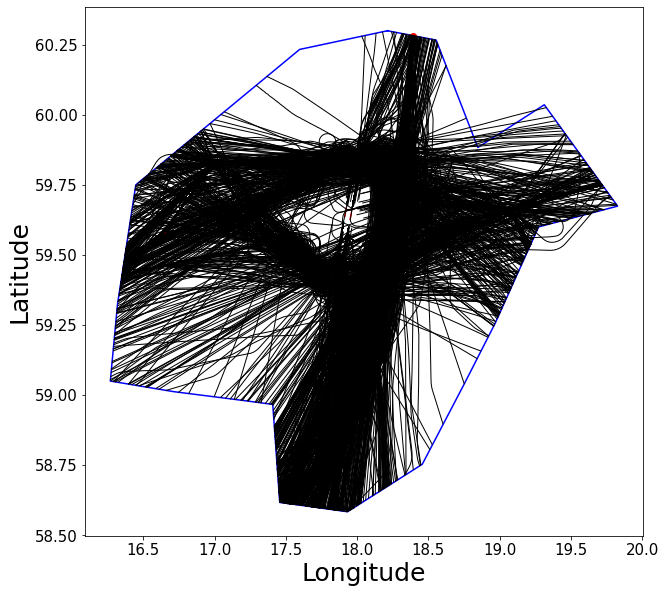

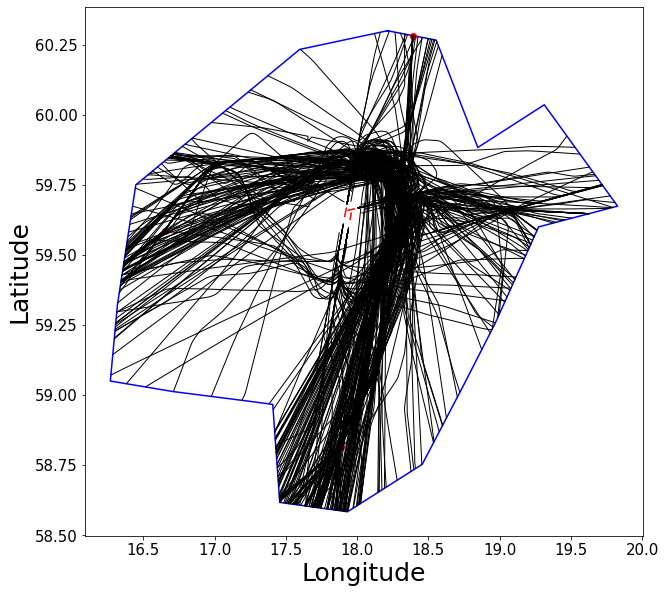

In [15]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_06_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_06_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_06_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_06_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_06_5.png")

In [16]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_07_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_07_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_07_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_07_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_07_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

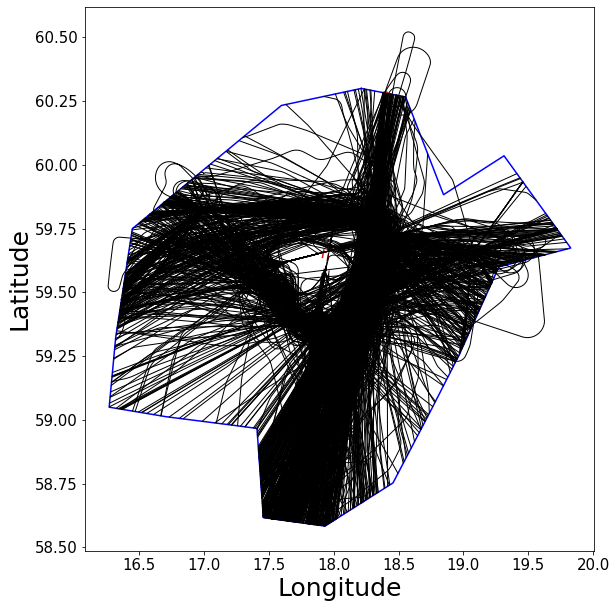

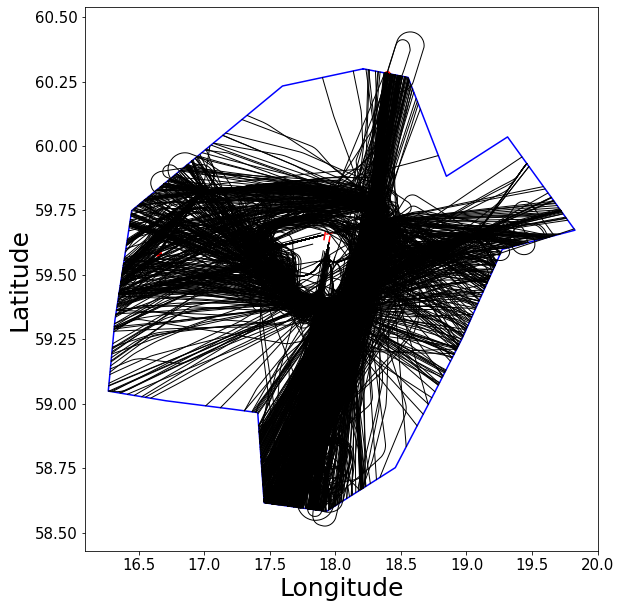

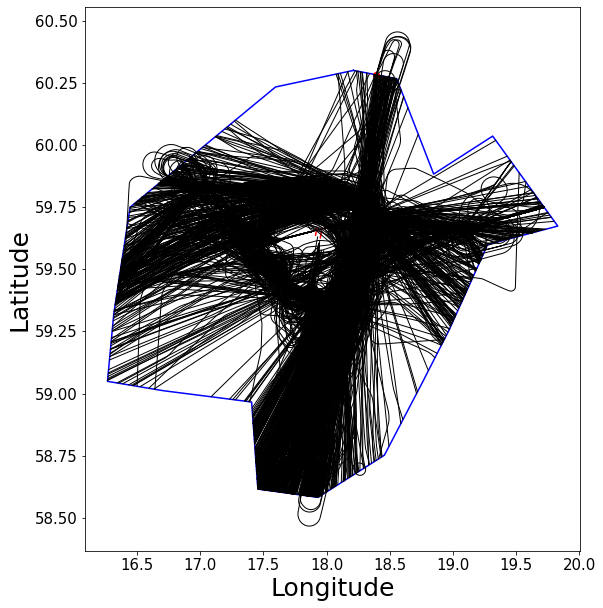

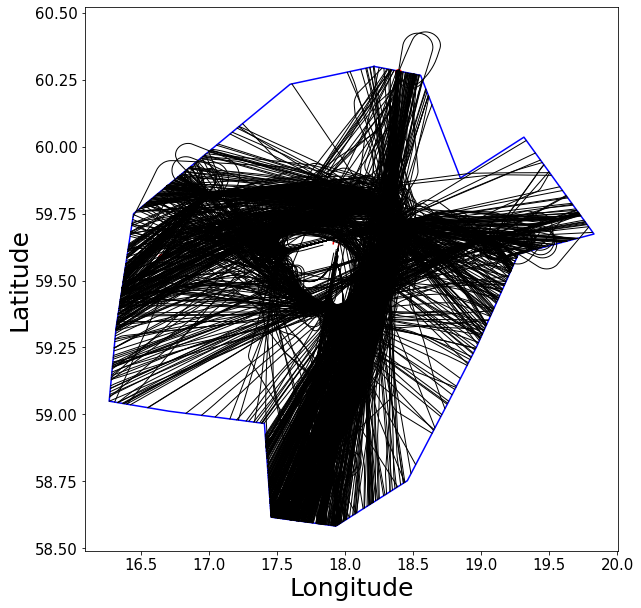

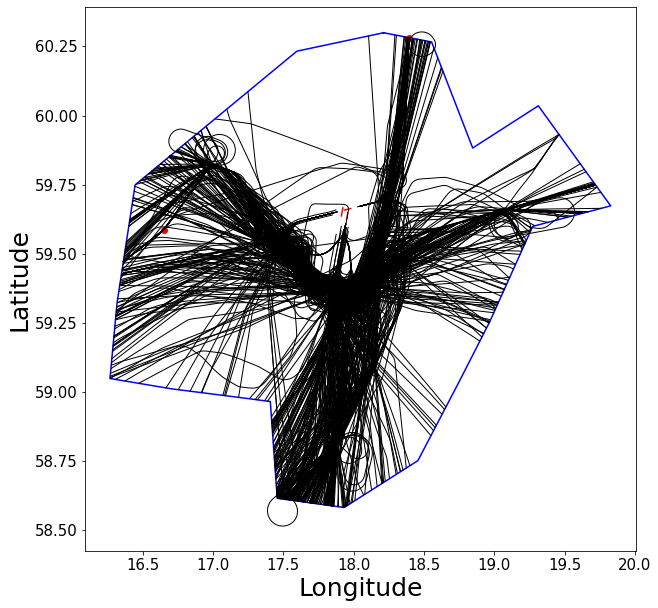

In [17]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_07_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_07_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_07_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_07_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_07_5.png")

In [18]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_08_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_08_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_08_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_08_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_08_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

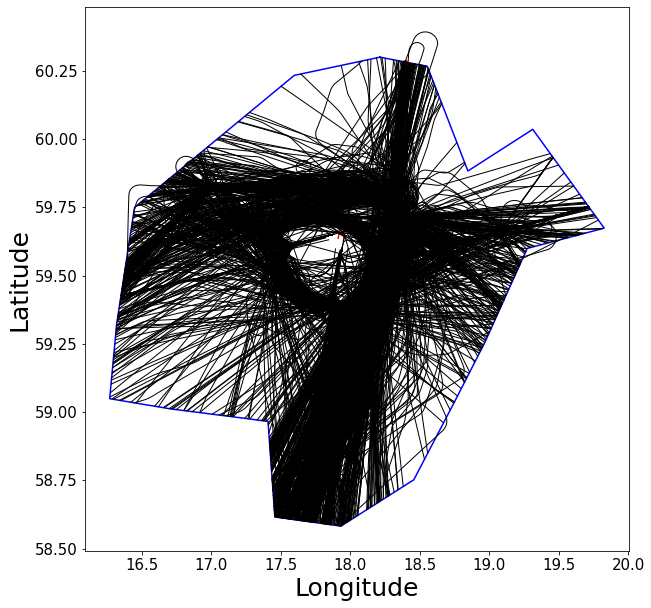

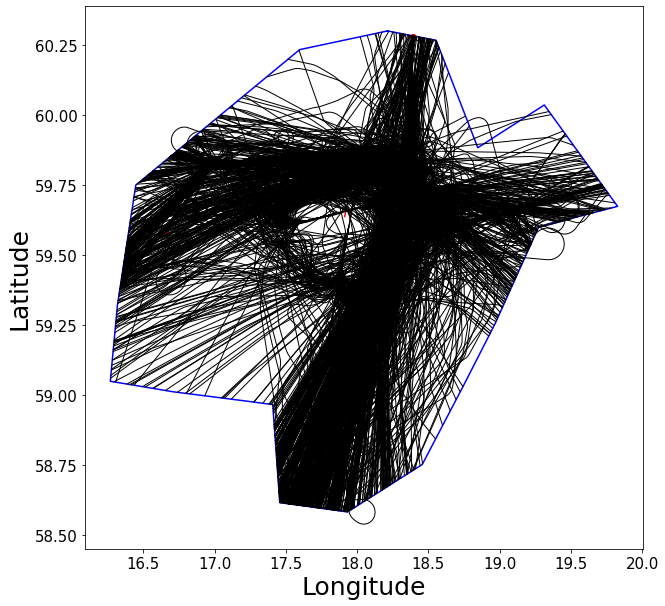

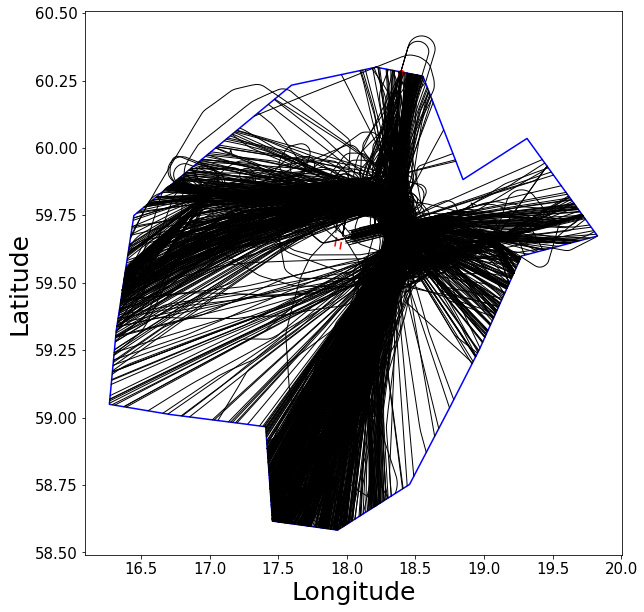

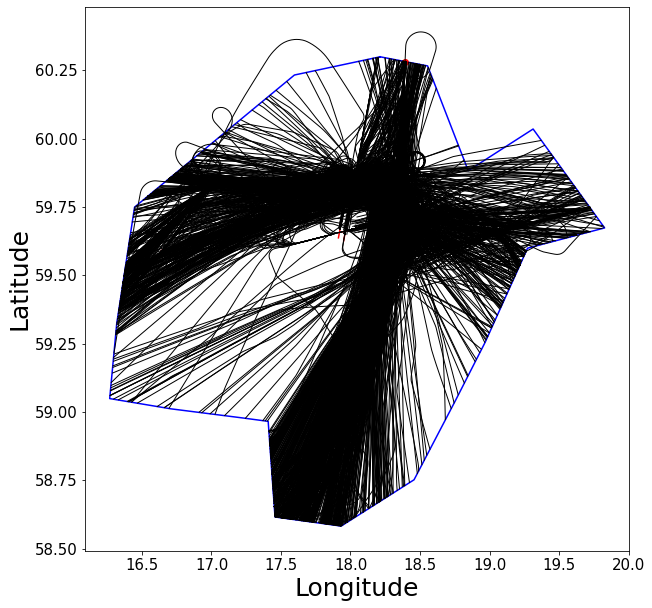

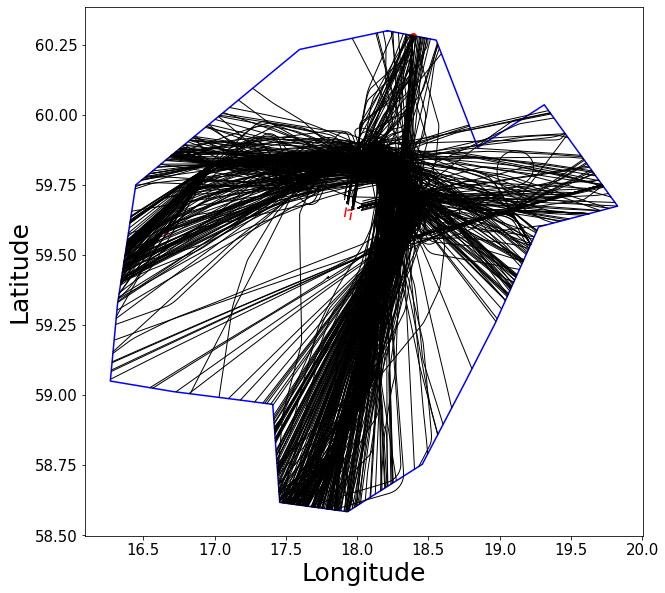

In [19]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_08_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_08_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_08_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_08_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_08_5.png")

In [20]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_09_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_09_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_09_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_09_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_09_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

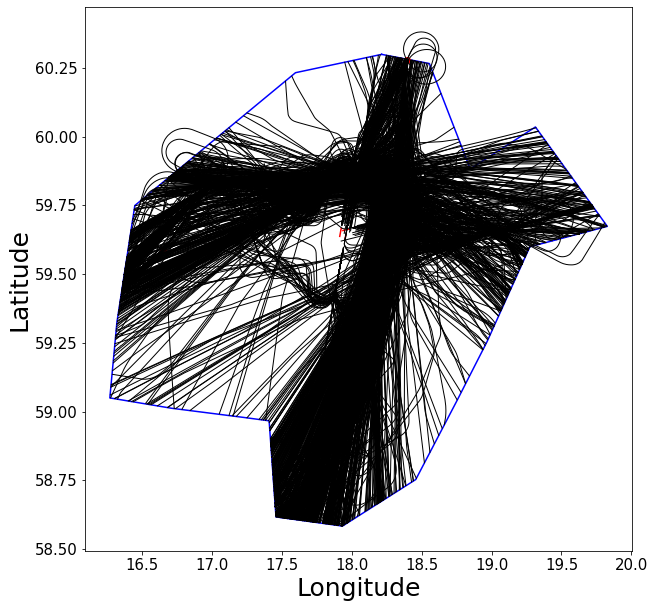

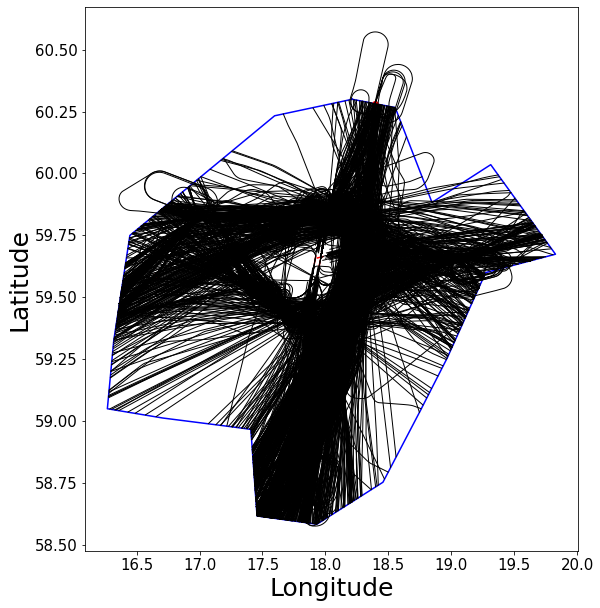

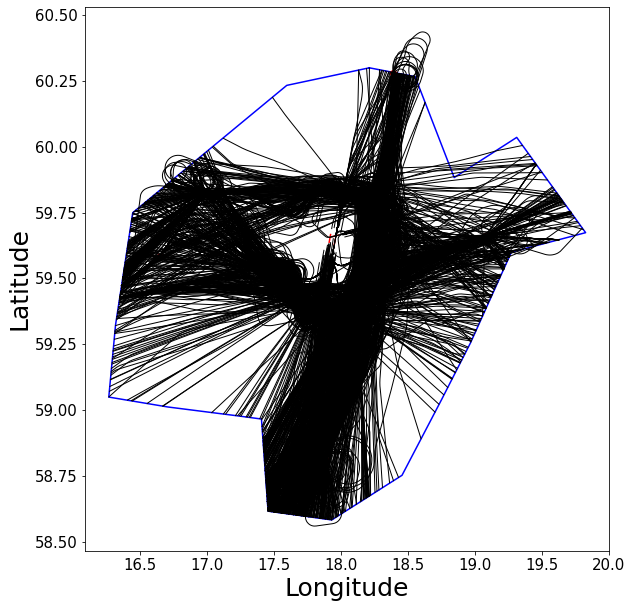

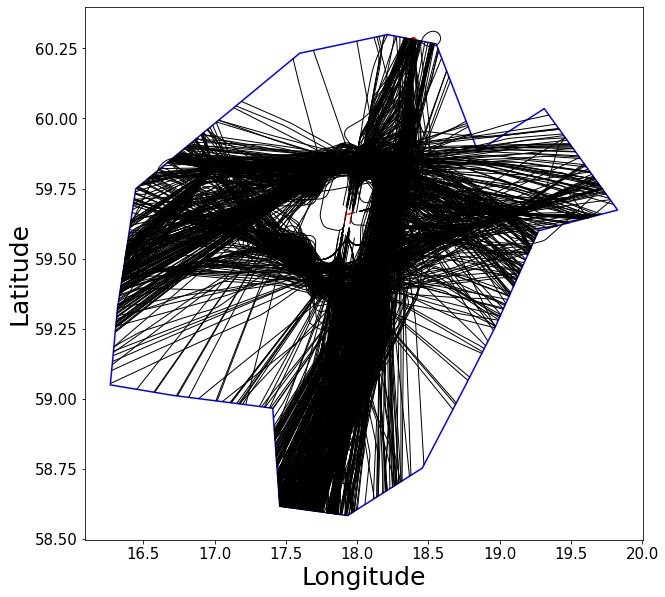

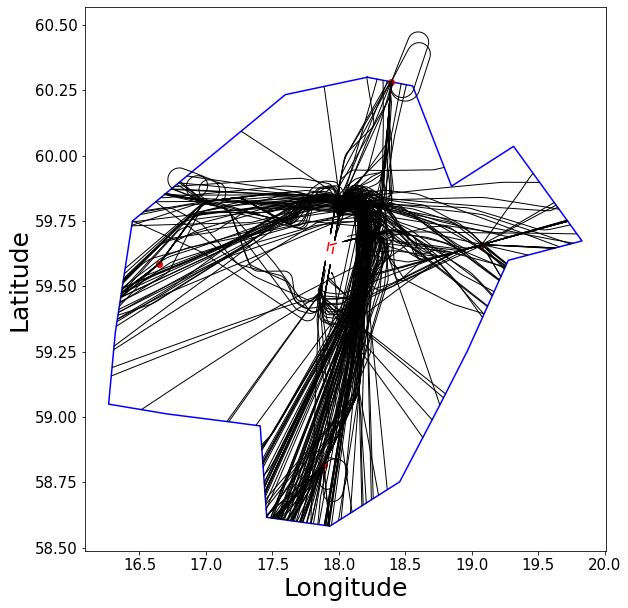

In [21]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_09_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_09_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_09_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_09_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_09_5.png")

In [22]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_10_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_10_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_10_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_10_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_10_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

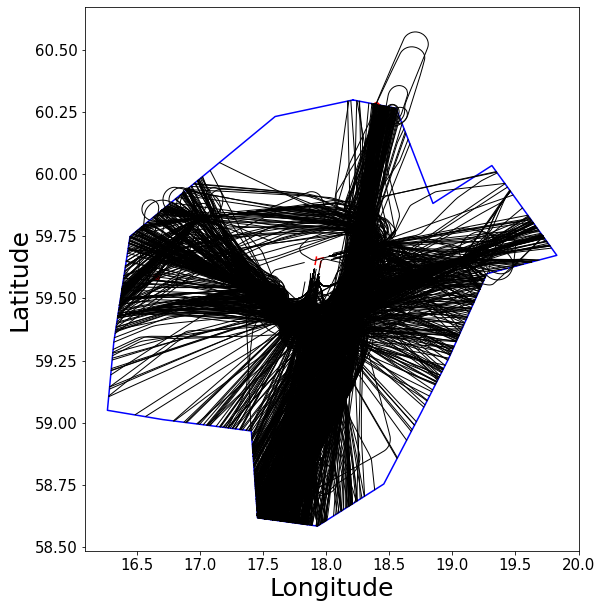

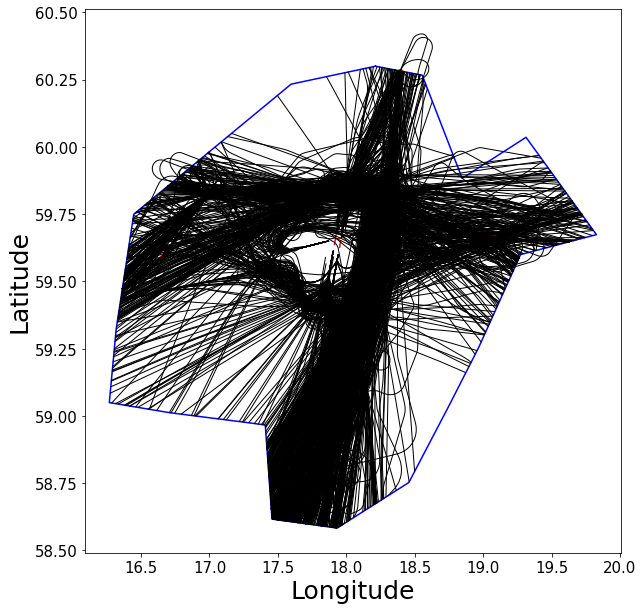

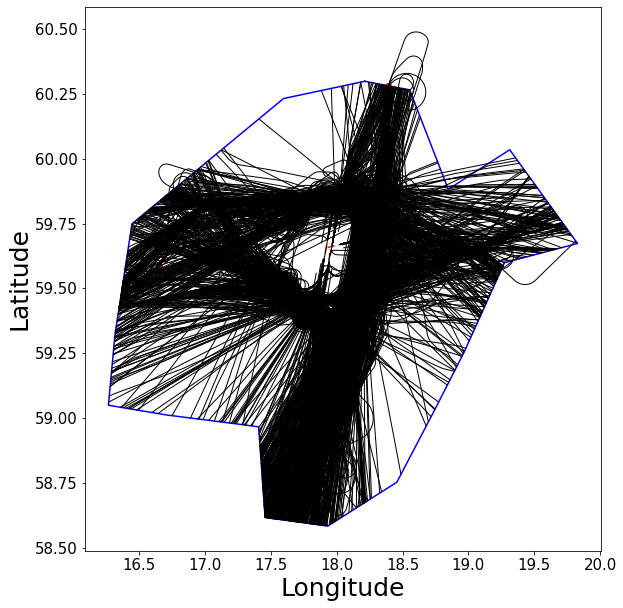

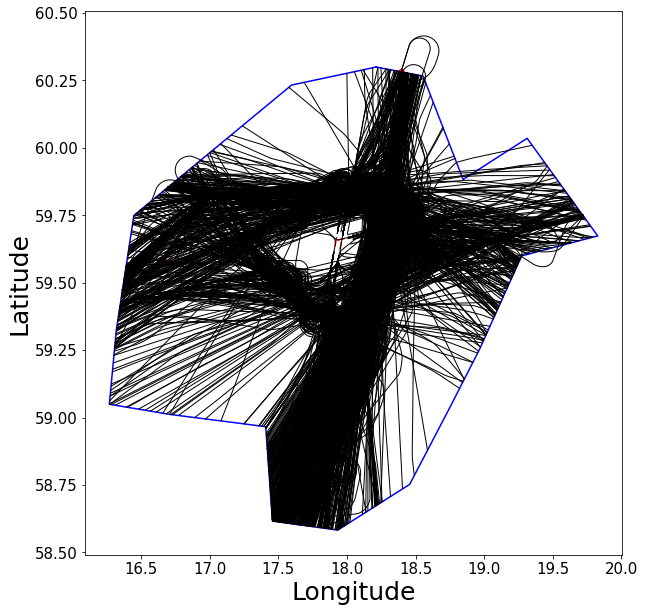

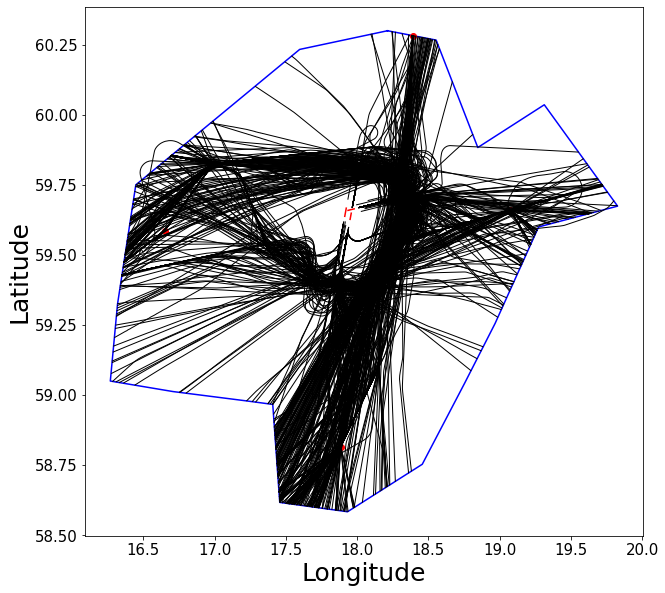

In [23]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_5.png")

In [24]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_11_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_11_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_11_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_11_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_11_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

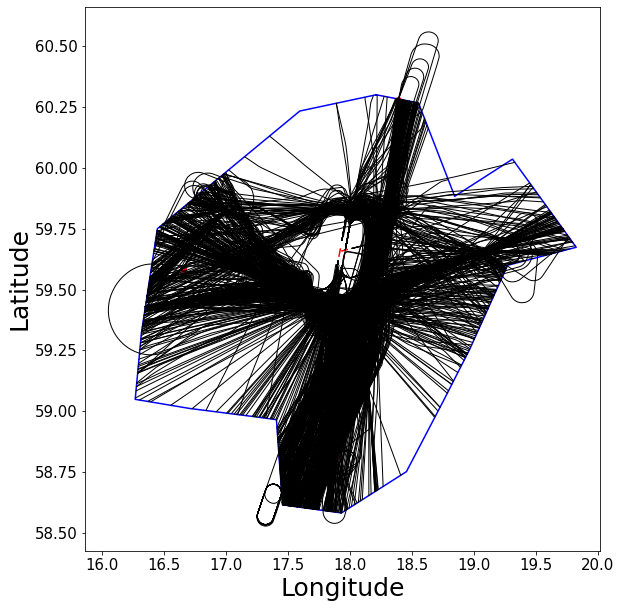

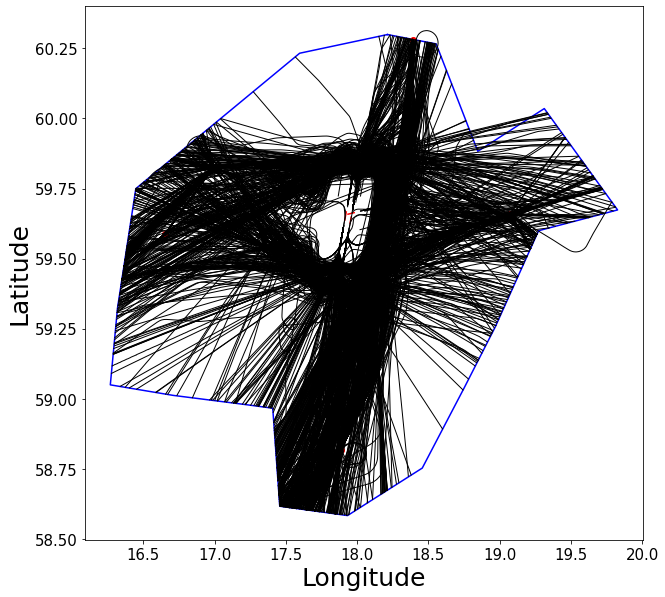

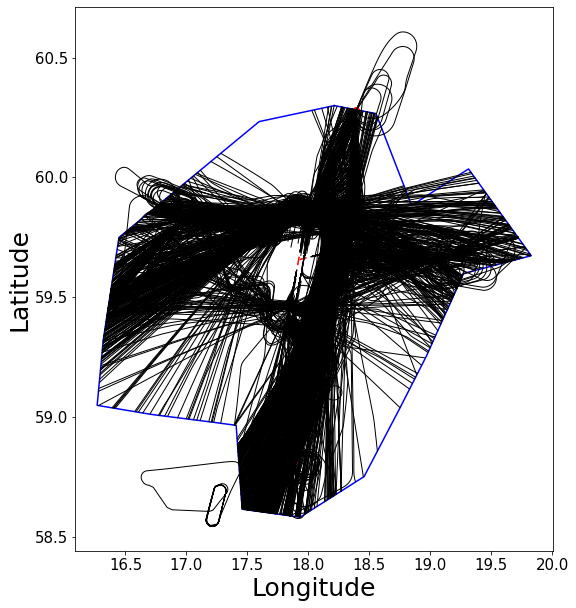

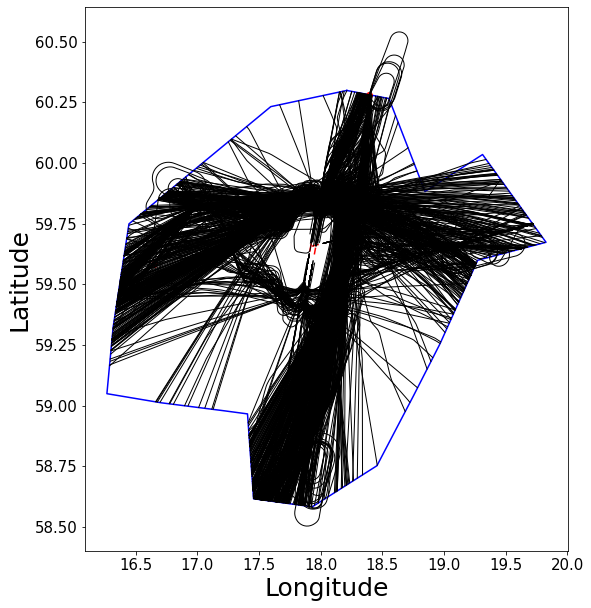

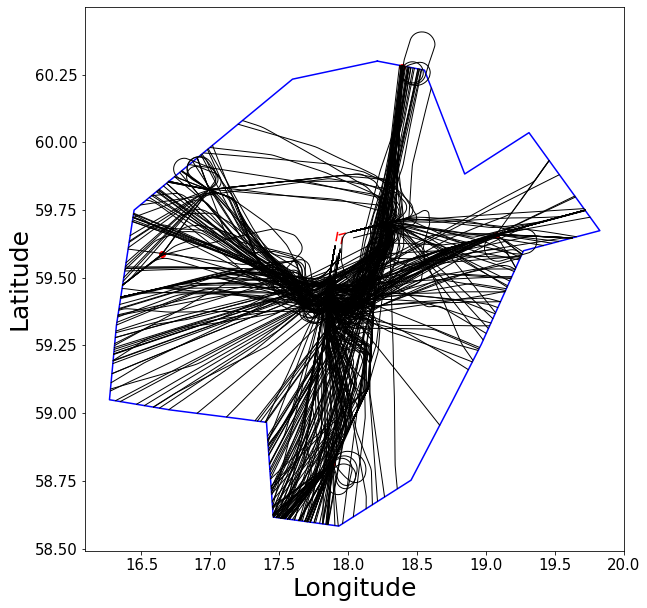

In [25]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_10_5.png")

In [26]:
filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_12_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_12_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_12_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_12_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2019/osn_ESSA_states_TMA_2019/osn_arrival_ESSA_states_TMA_2019_12_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

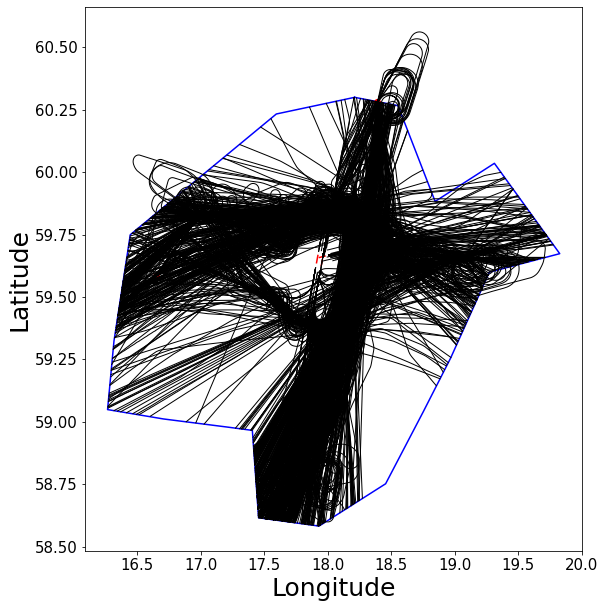

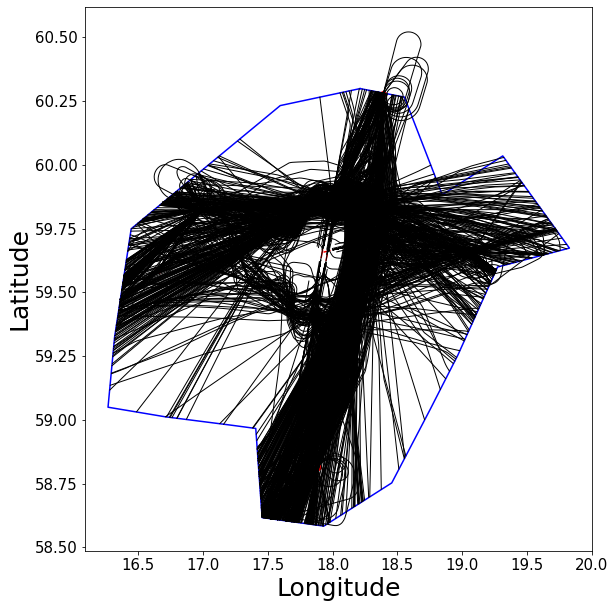

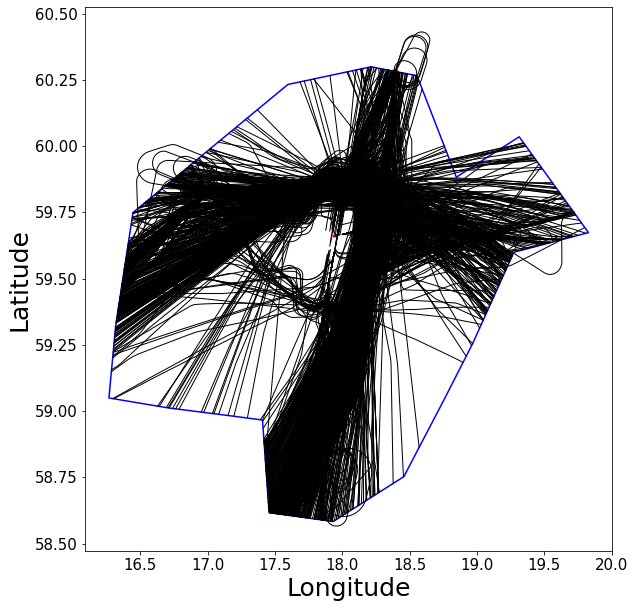

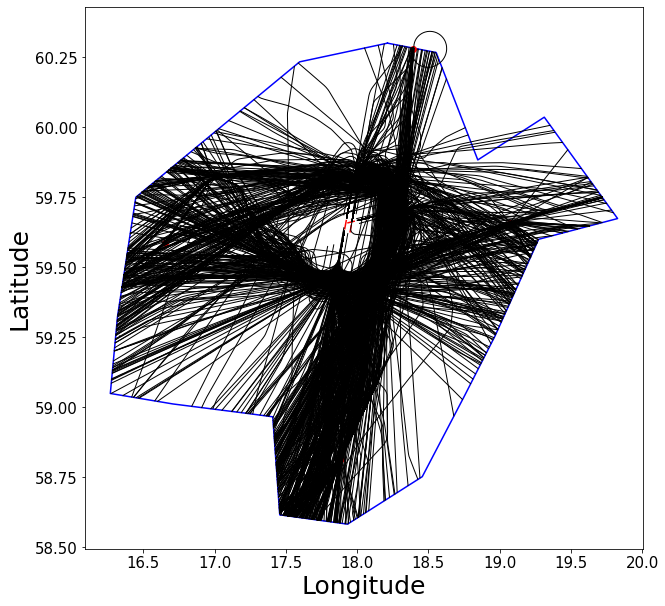

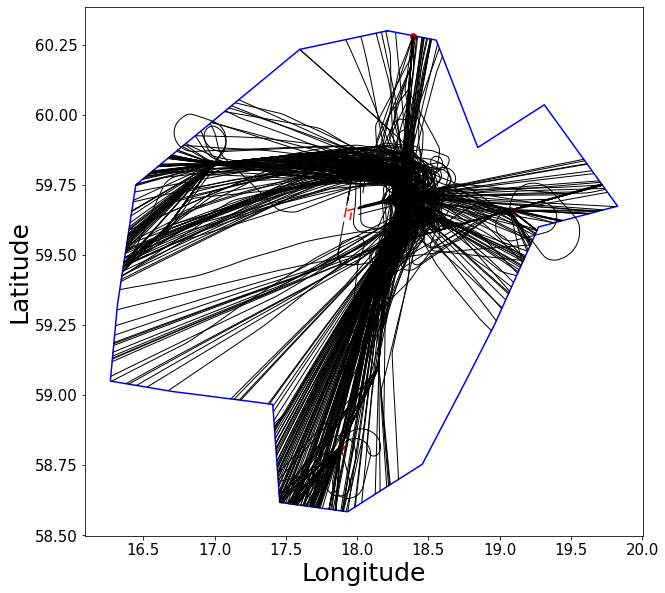

In [27]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_12_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_12_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_12_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_12_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2019_12_5.png")

In [28]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_01_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_01_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_01_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_01_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_01_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

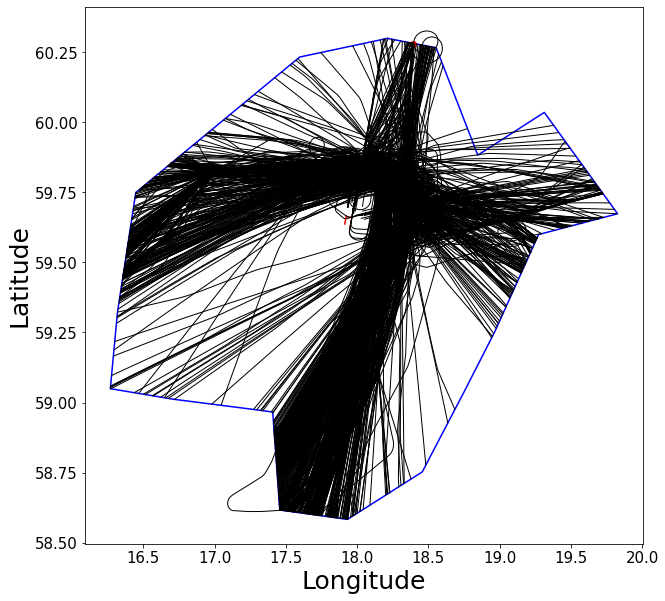

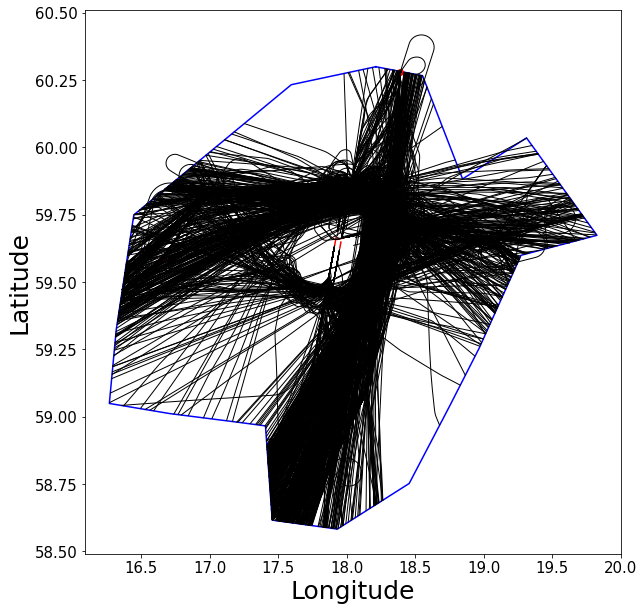

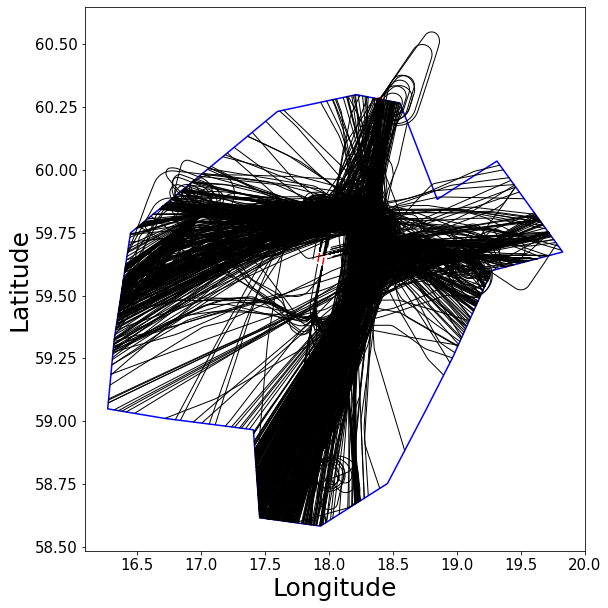

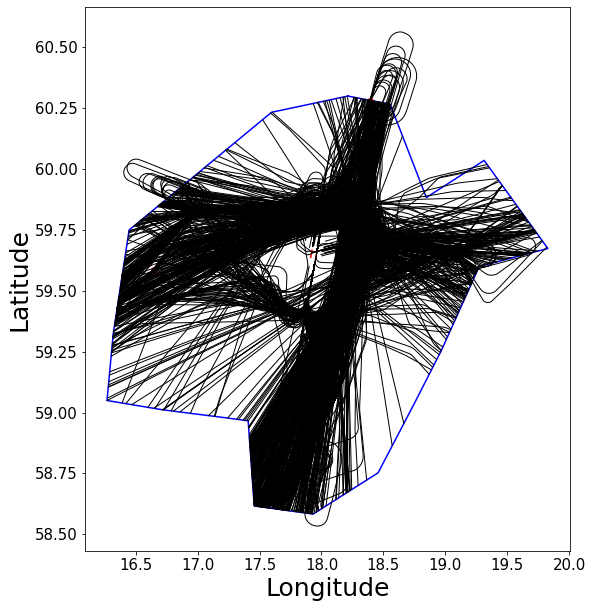

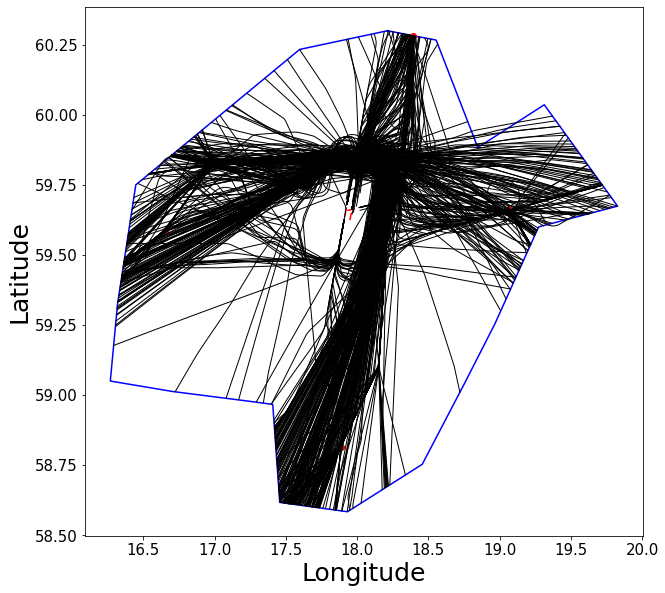

In [29]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_01_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_01_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_01_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_01_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_01_5.png")

In [30]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_02_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_02_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_02_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_02_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_02_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

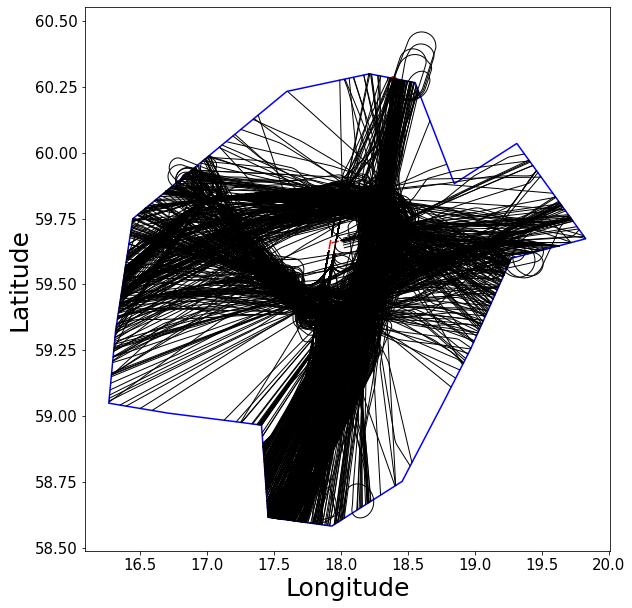

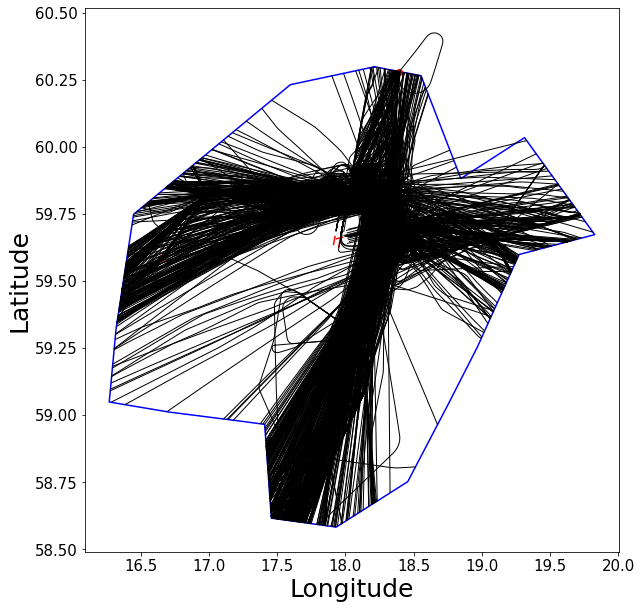

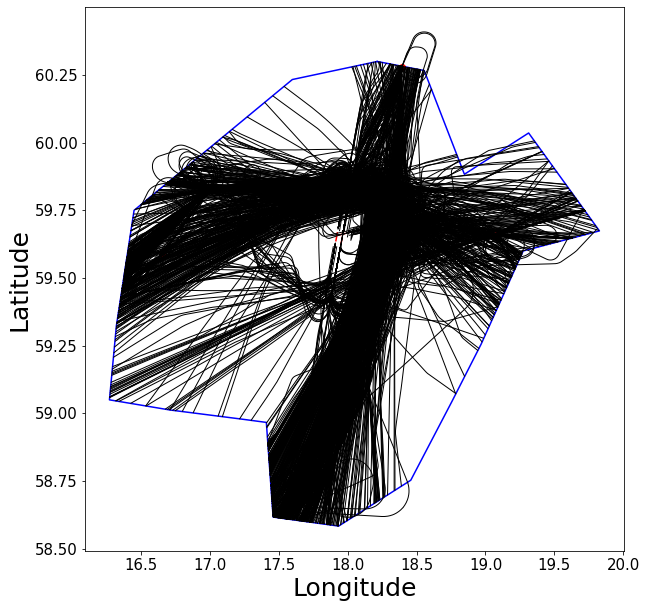

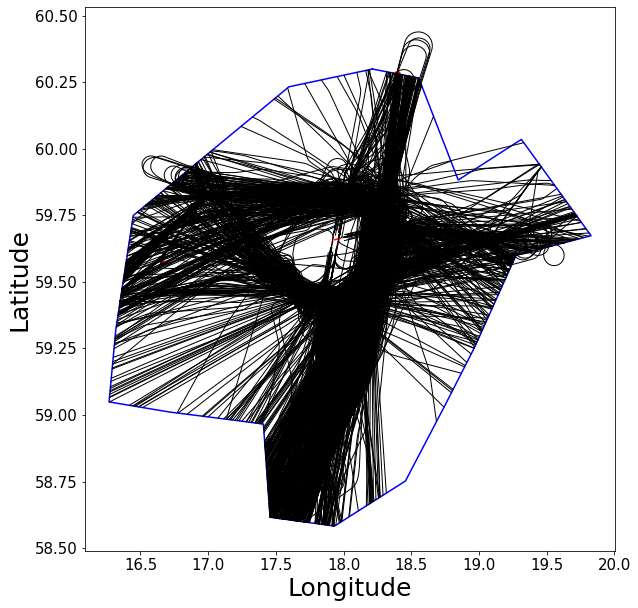

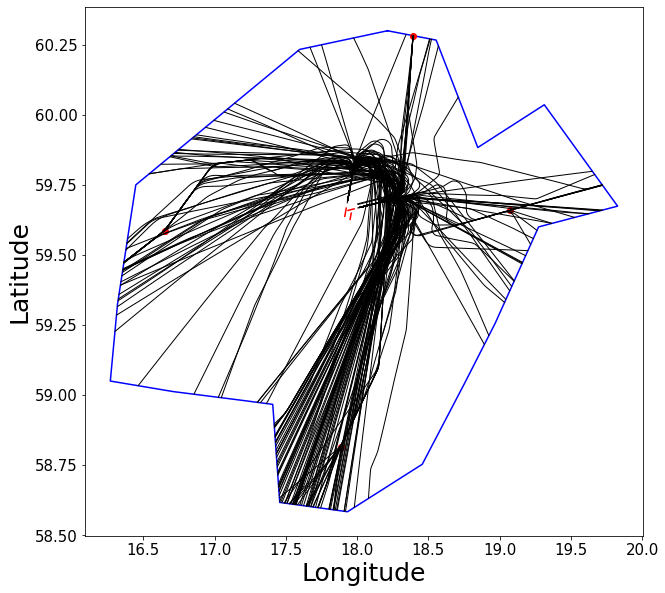

In [31]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_02_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_02_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_02_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_02_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_02_5.png")

In [32]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_03_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_03_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_03_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_03_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_03_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

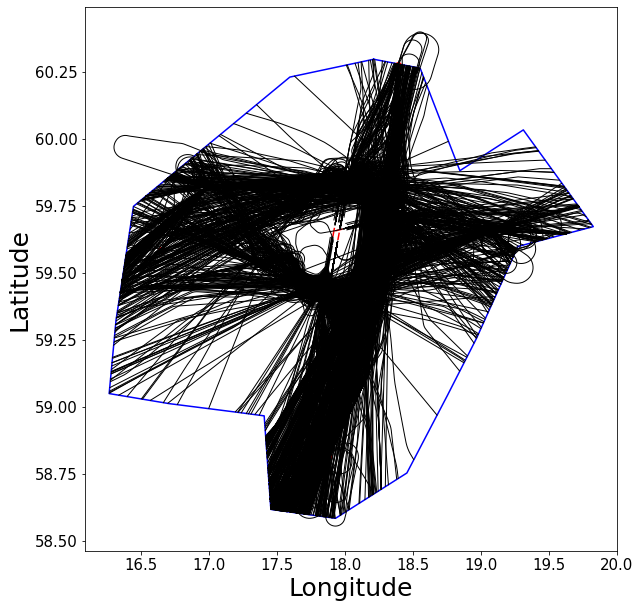

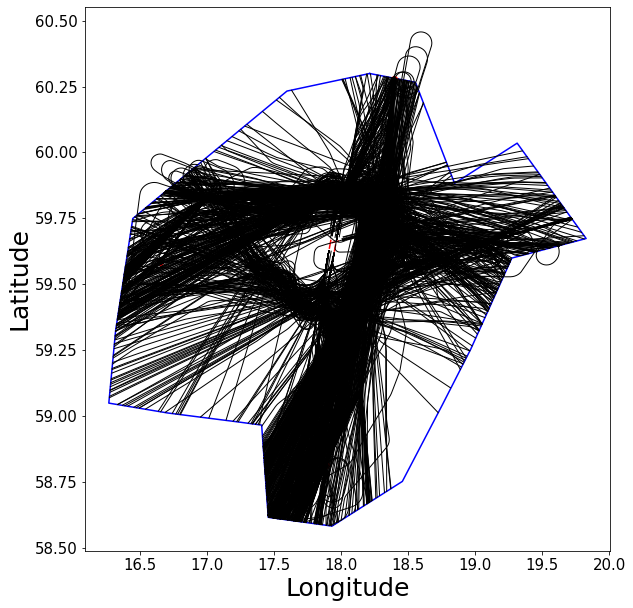

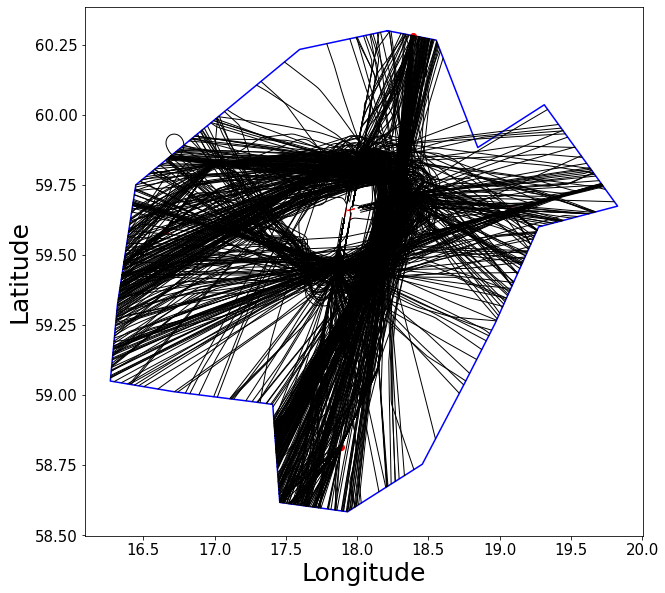

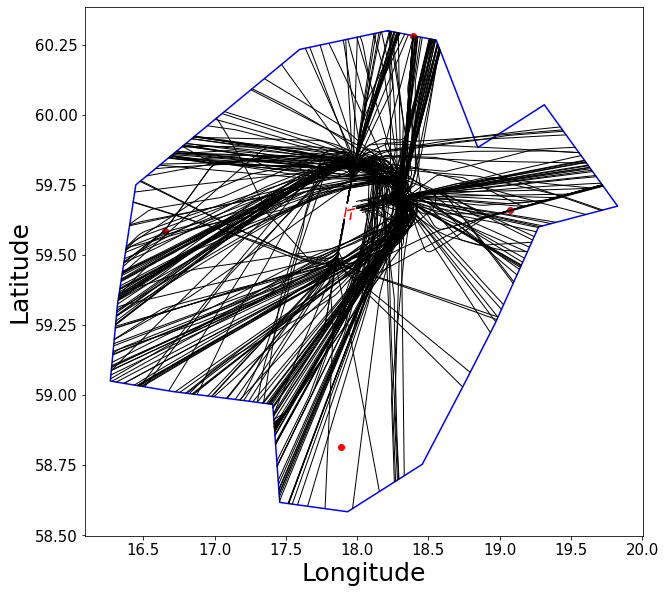

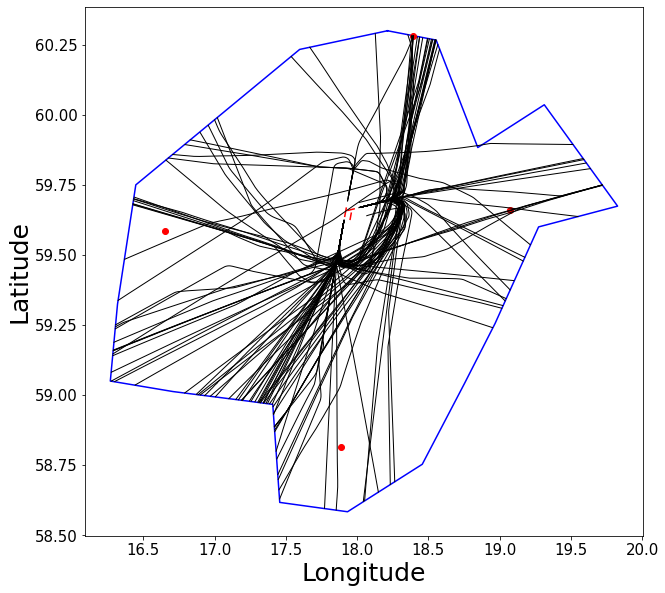

In [33]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_03_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_03_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_03_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_03_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_03_5.png")

In [34]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_04_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_04_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_04_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_04_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_04_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

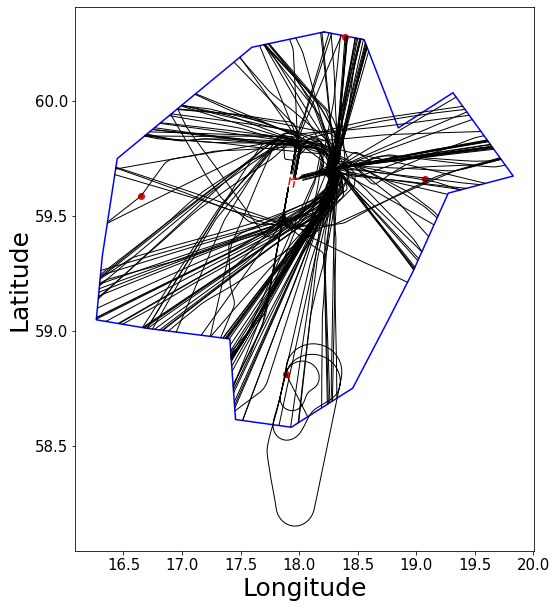

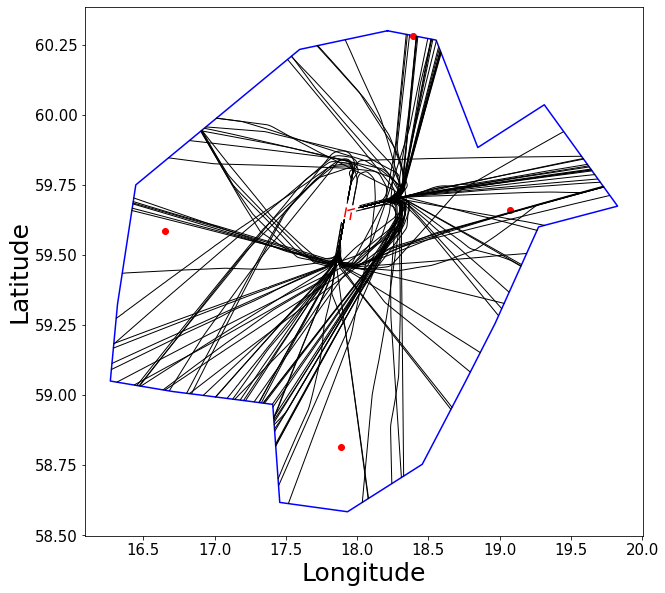

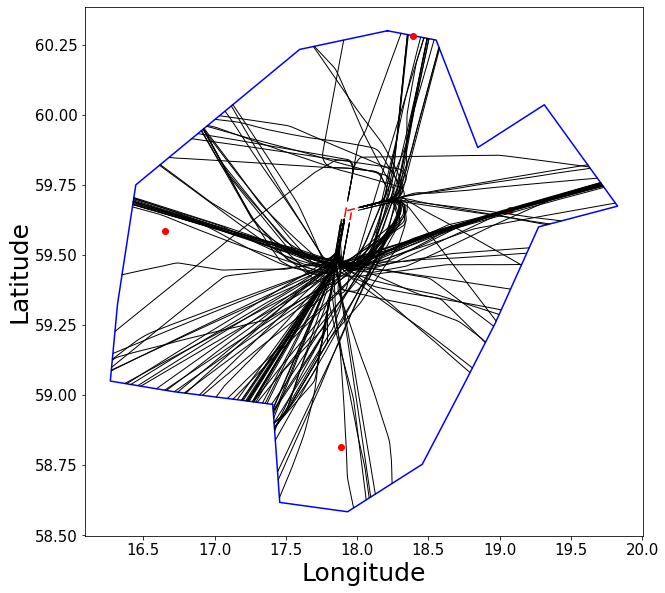

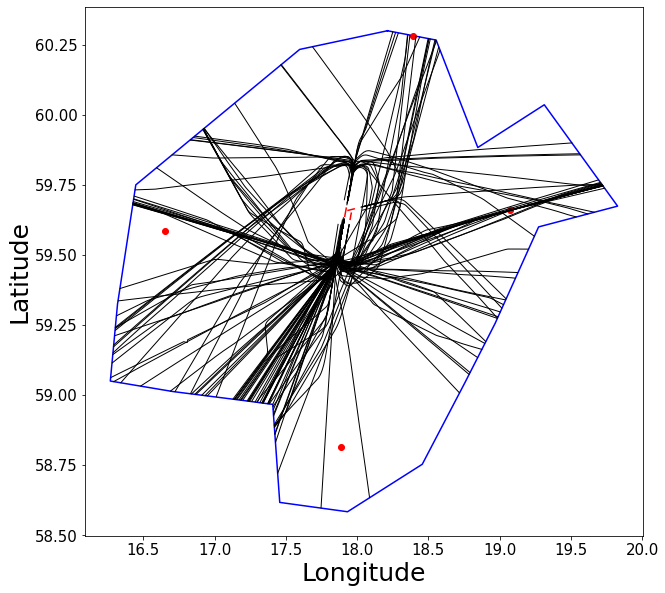

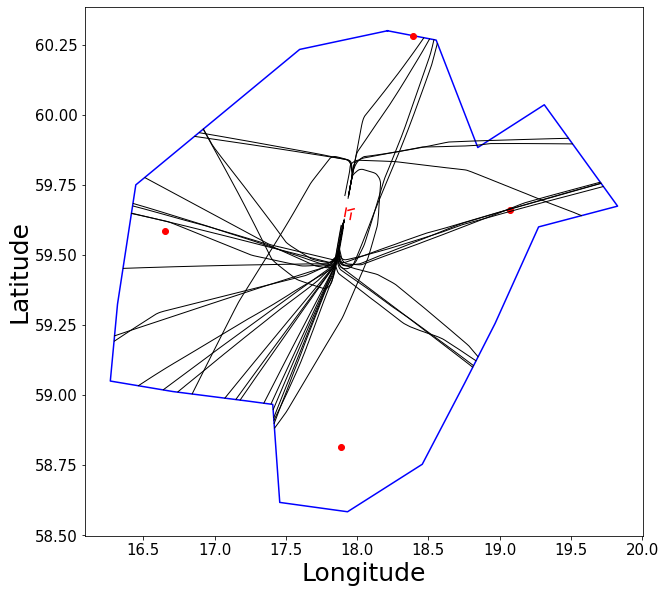

In [35]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_04_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_04_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_04_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_04_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_04_5.png")

In [36]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_05_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_05_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_05_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_05_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_05_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

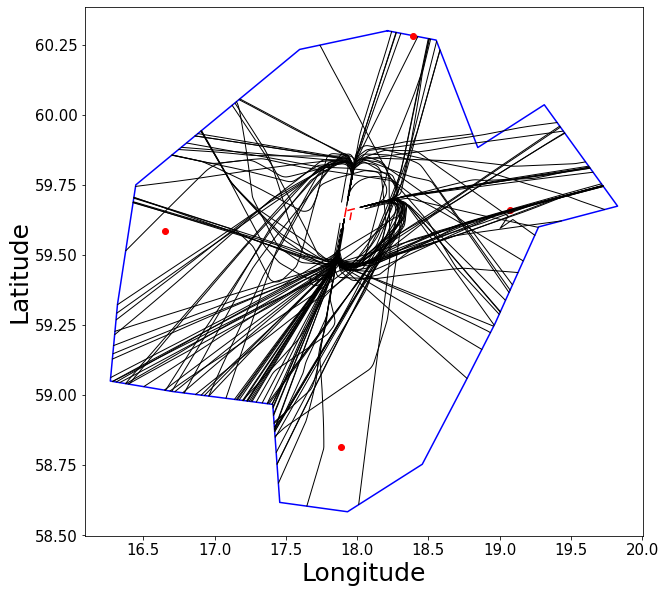

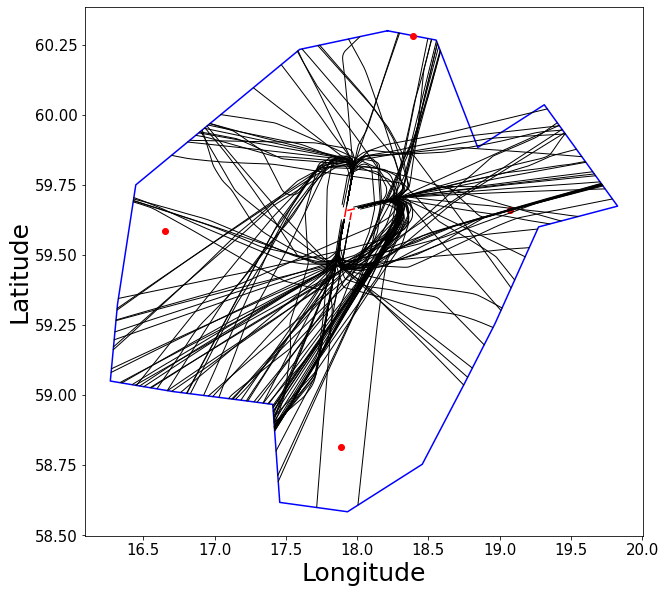

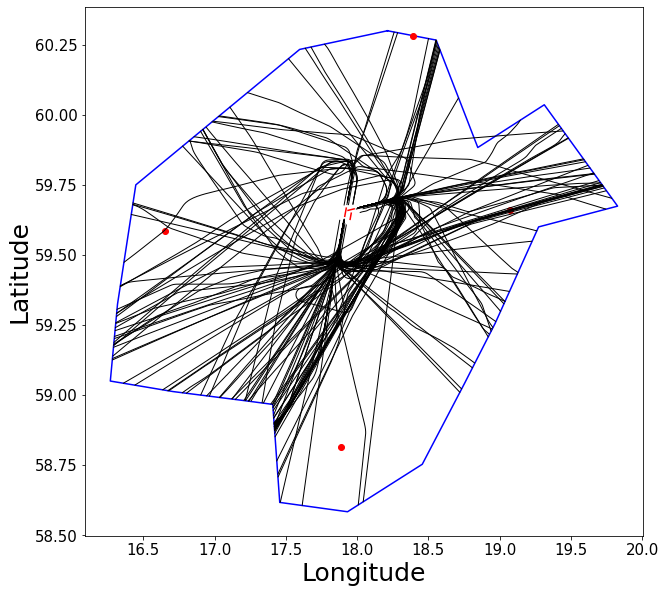

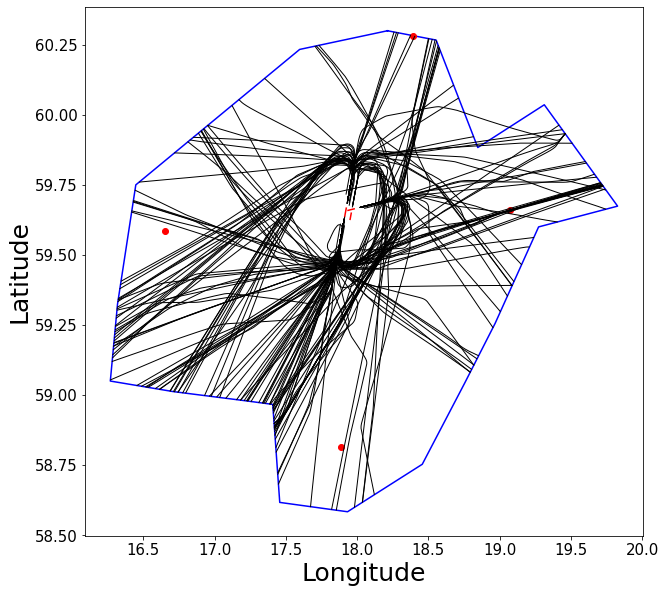

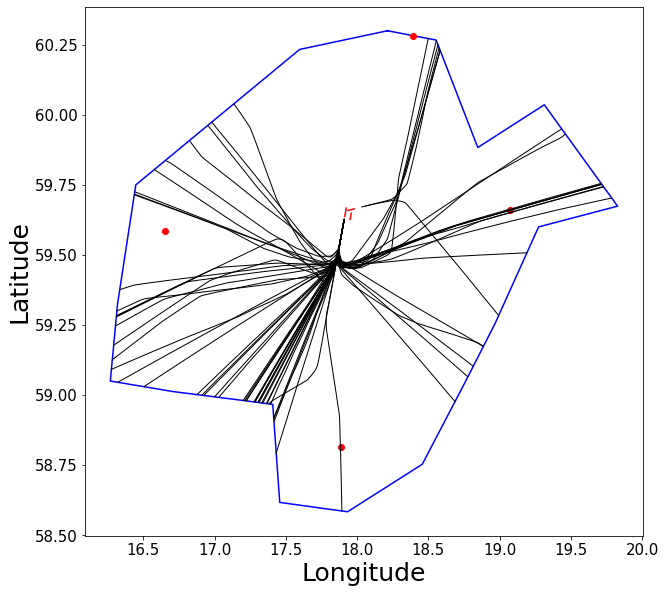

In [37]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_05_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_05_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_05_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_05_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_05_5.png")

In [38]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_06_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_06_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_06_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_06_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_06_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

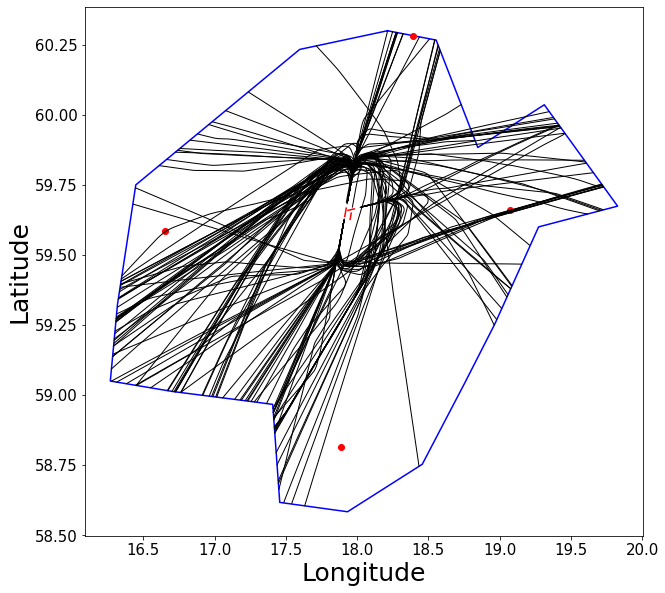

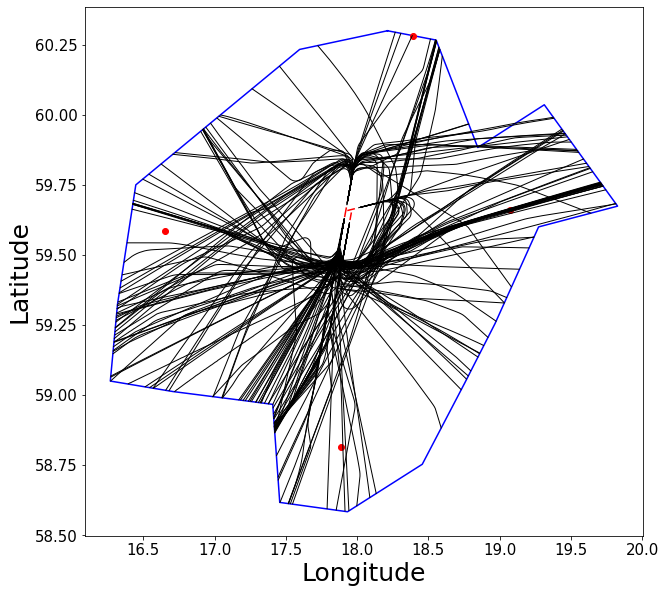

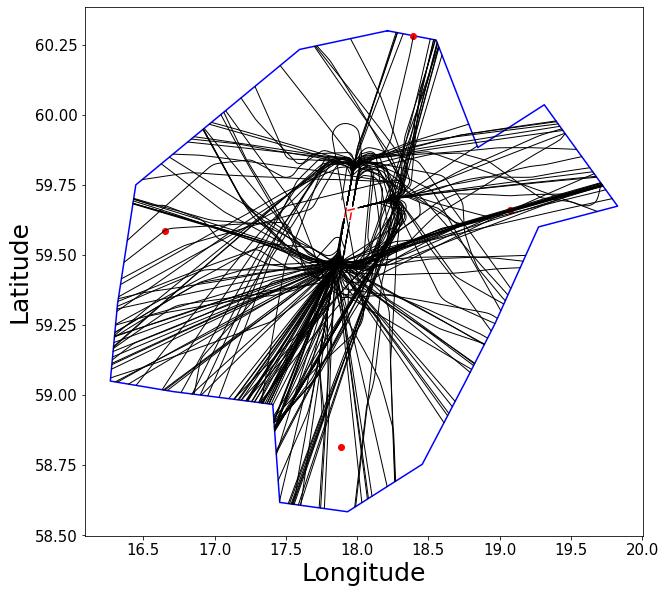

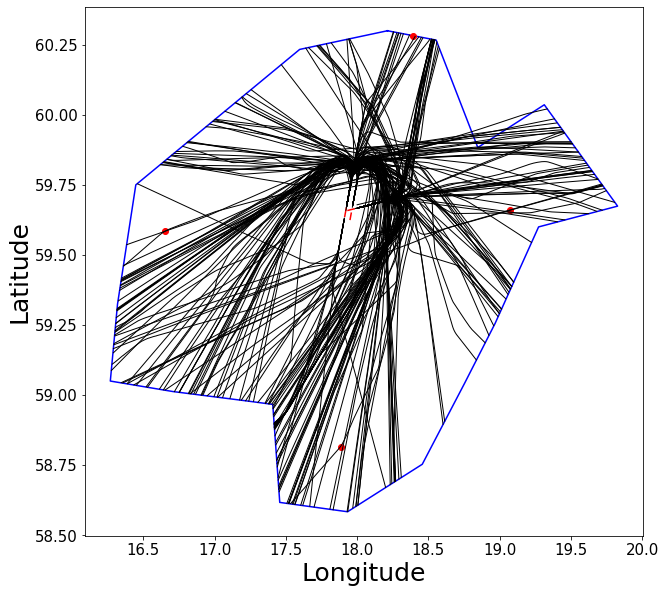

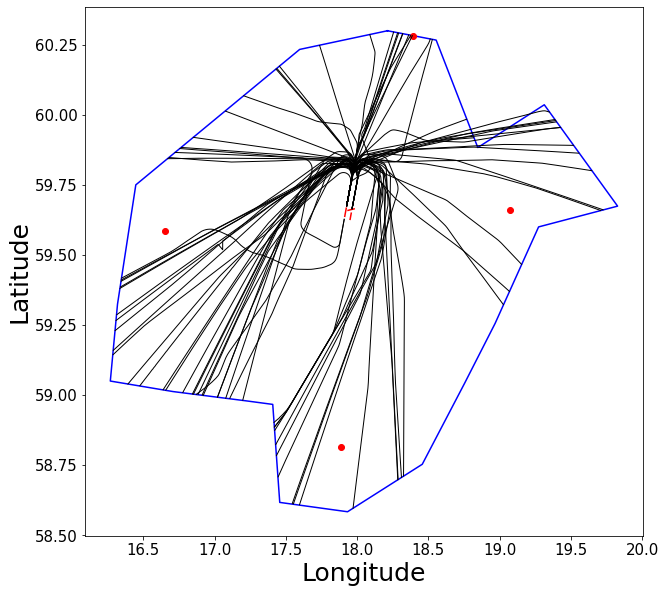

In [39]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_06_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_06_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_06_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_06_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_06_5.png")

In [40]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_07_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_07_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_07_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_07_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_07_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

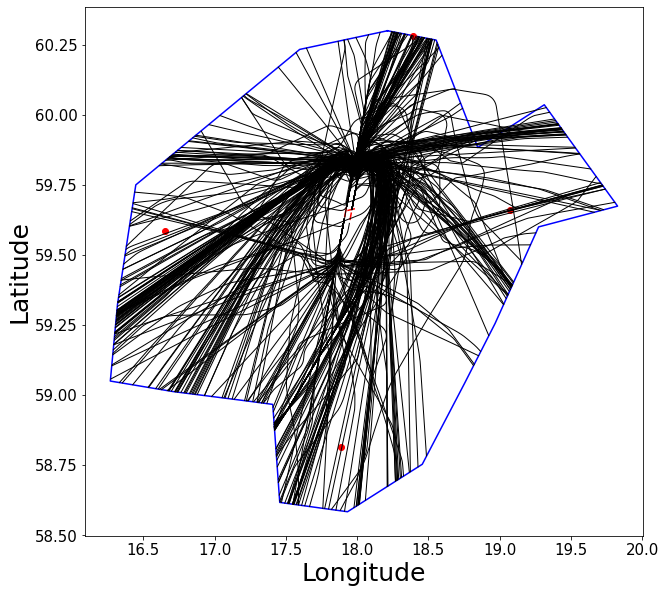

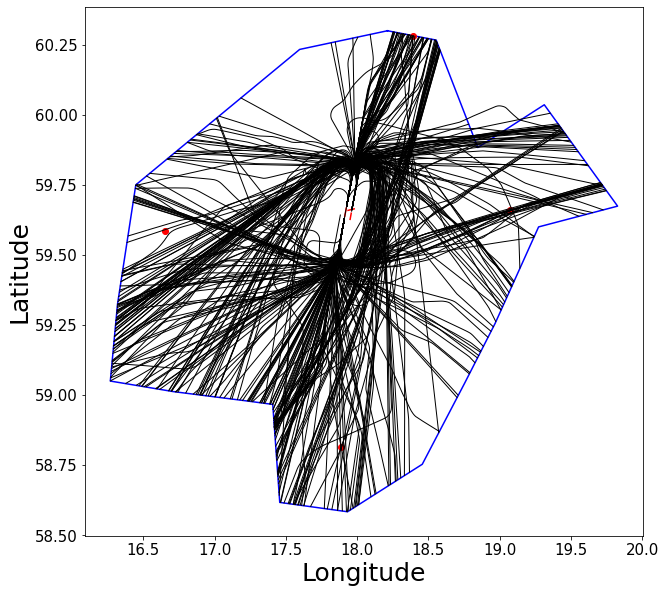

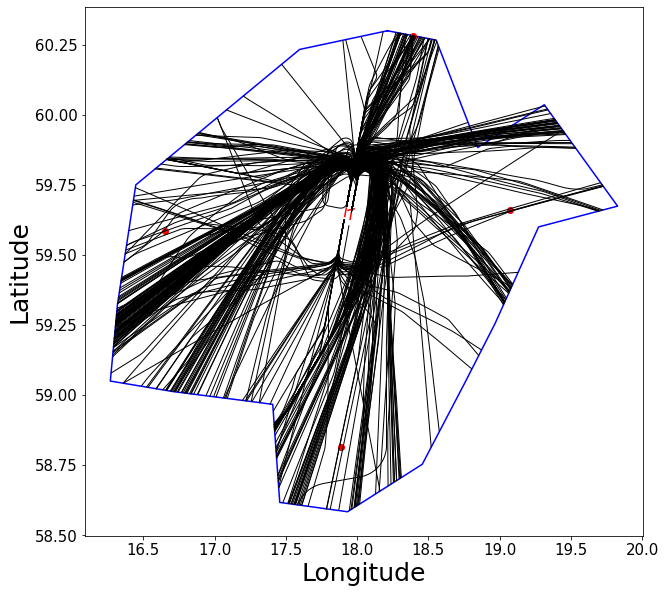

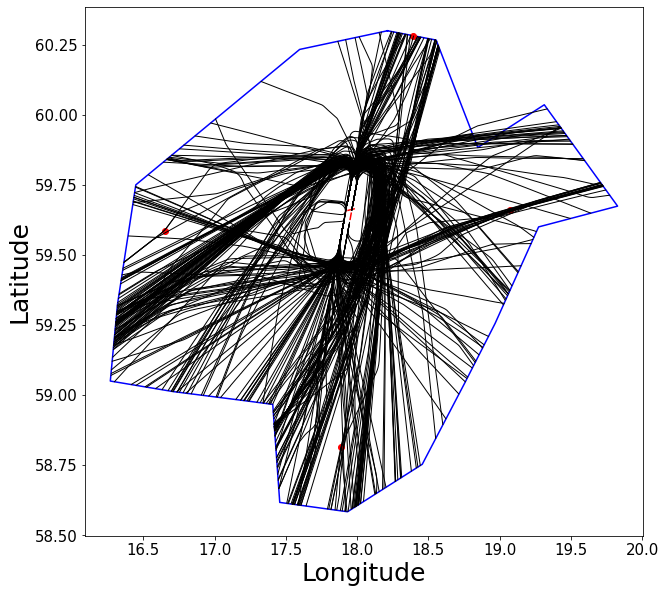

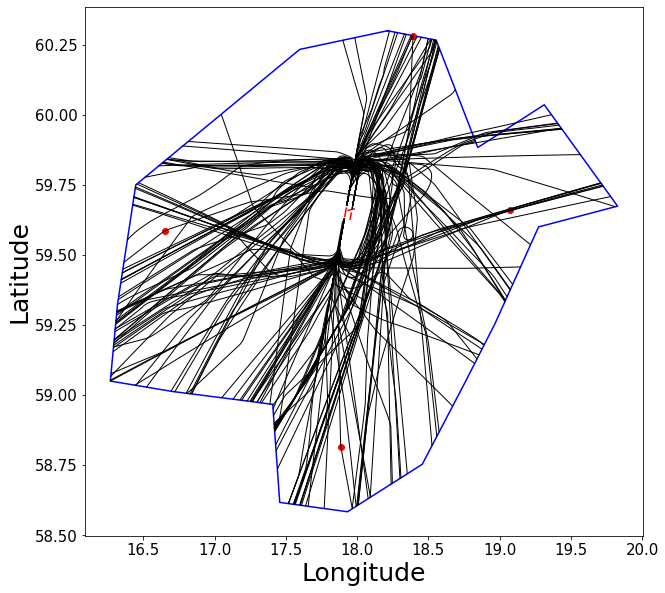

In [41]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_07_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_07_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_07_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_07_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_07_5.png")

In [42]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_08_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_08_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_08_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_08_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_08_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

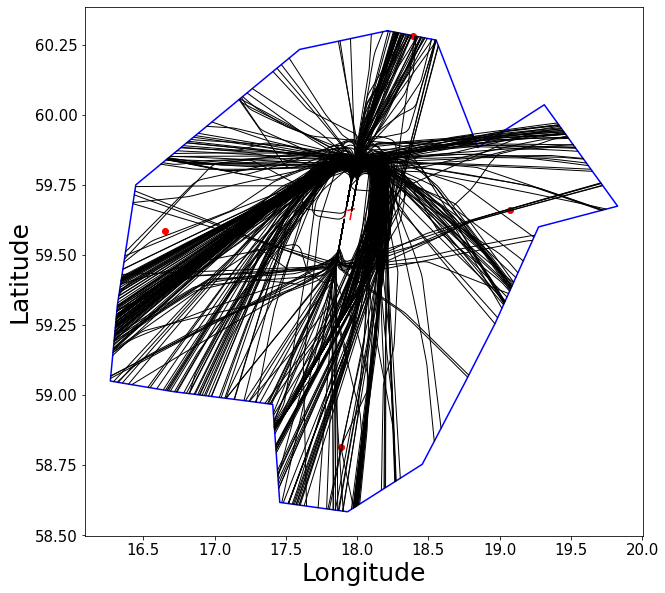

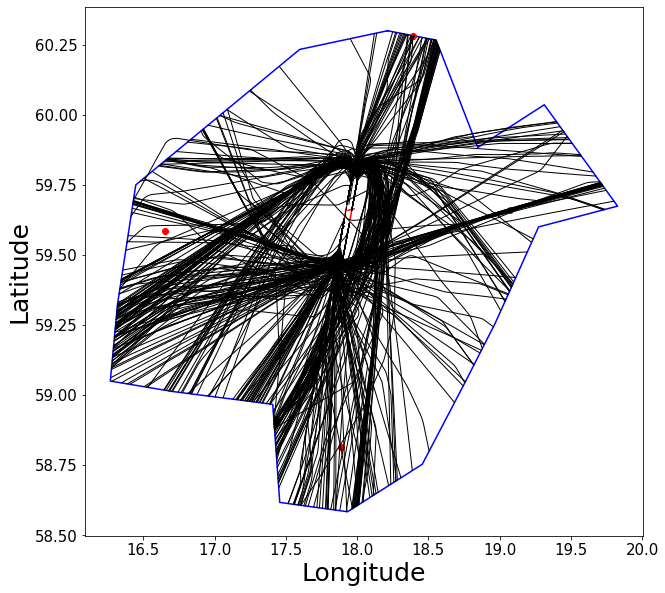

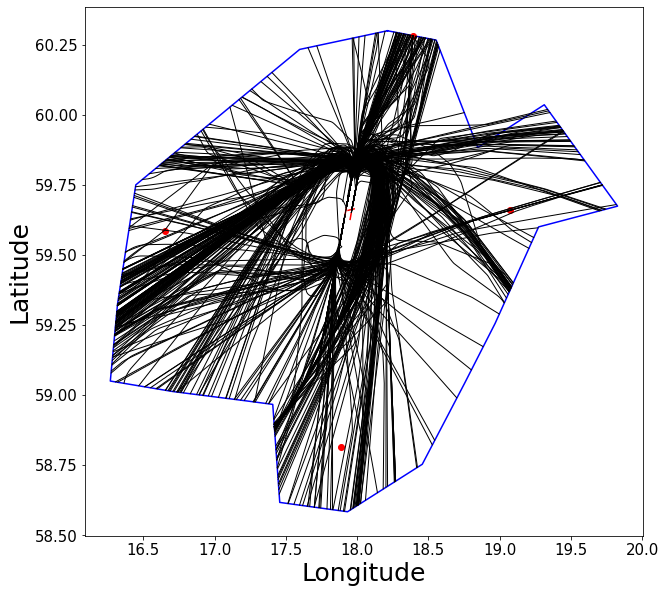

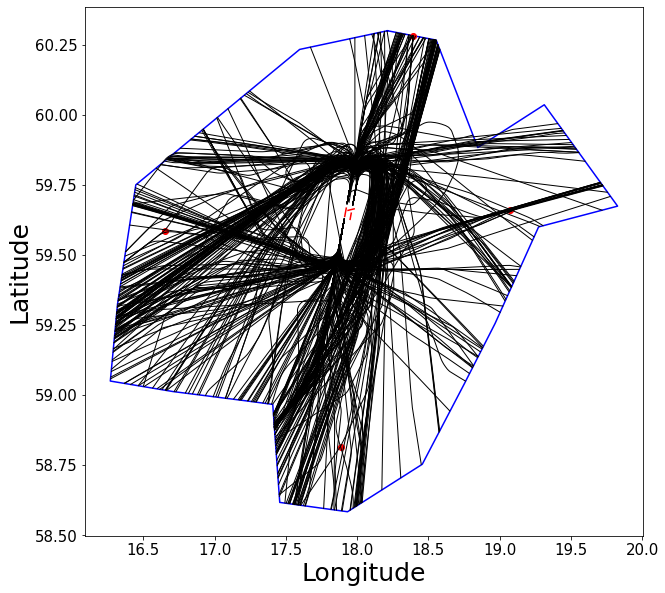

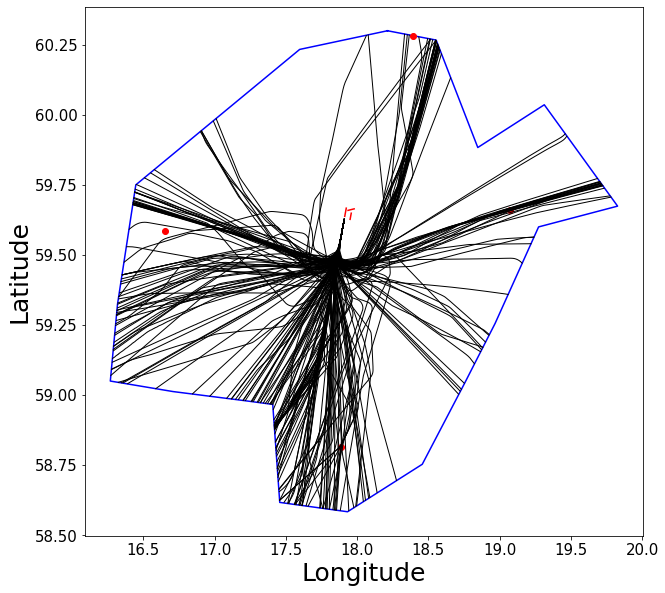

In [43]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_08_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_08_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_08_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_08_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_08_5.png")

In [44]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_09_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_09_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_09_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_09_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_09_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

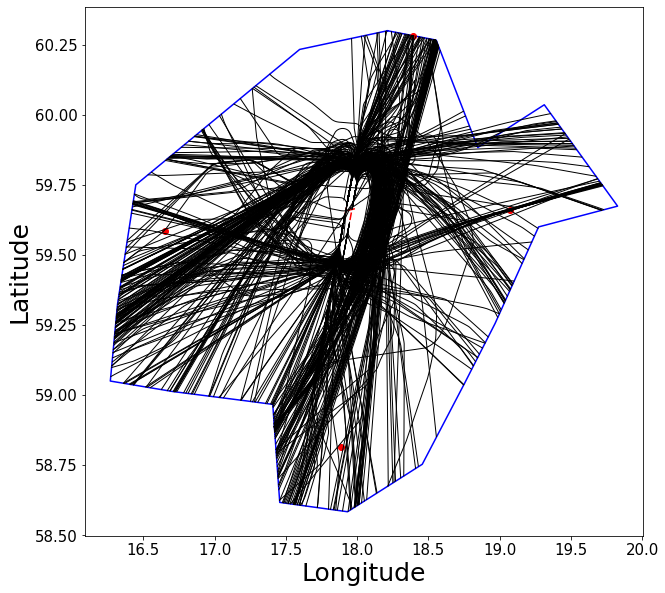

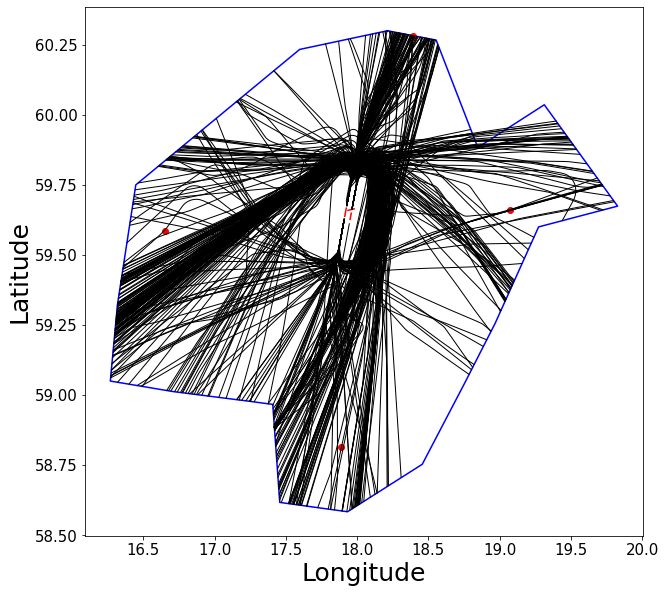

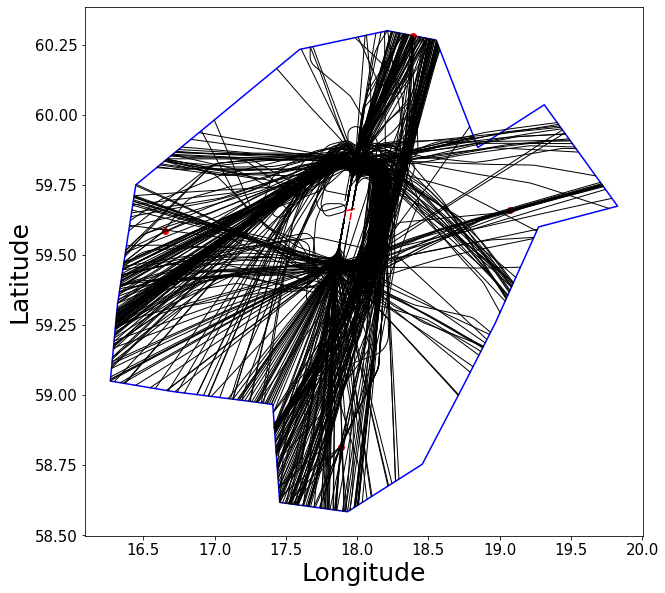

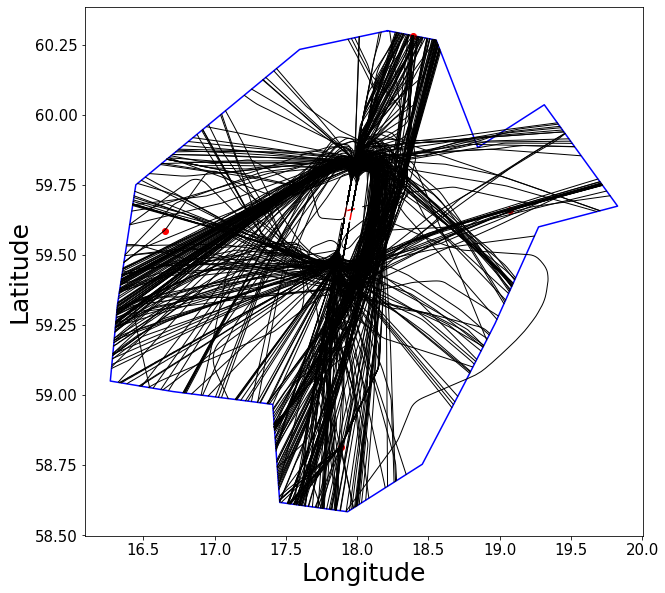

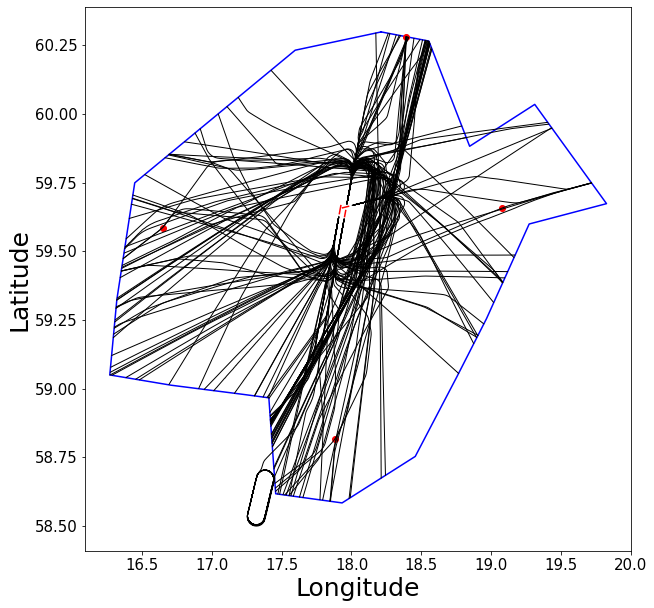

In [45]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_09_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_09_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_09_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_09_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_09_5.png")

In [46]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_10_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_10_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_10_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_10_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_10_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

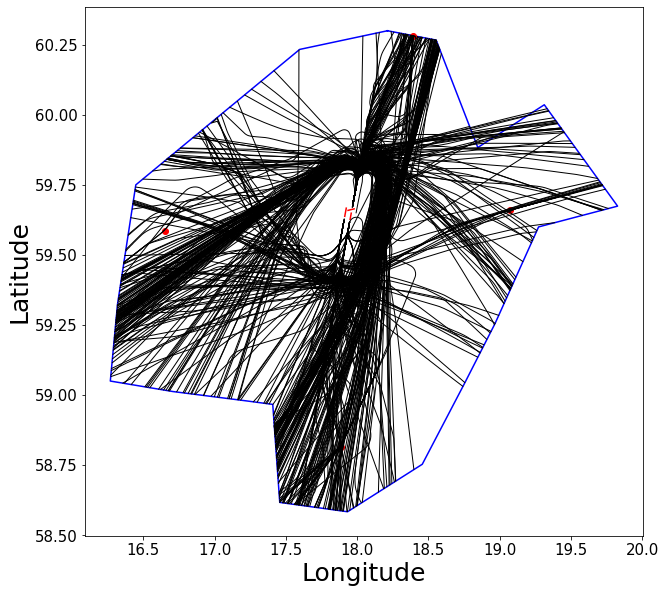

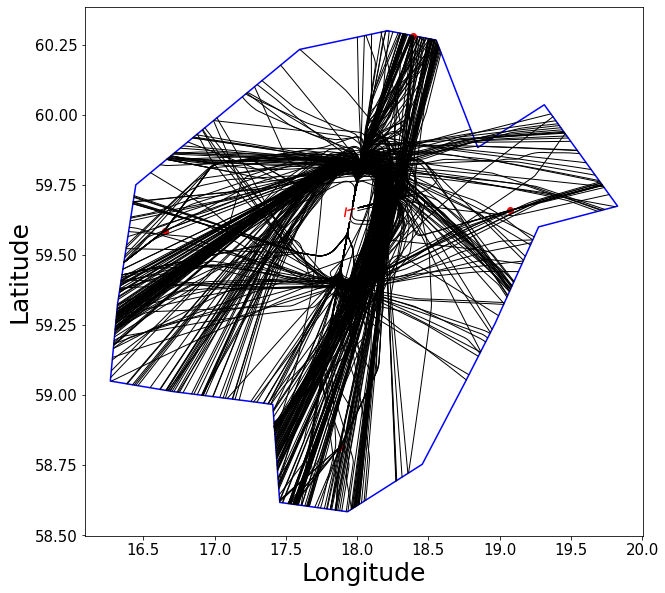

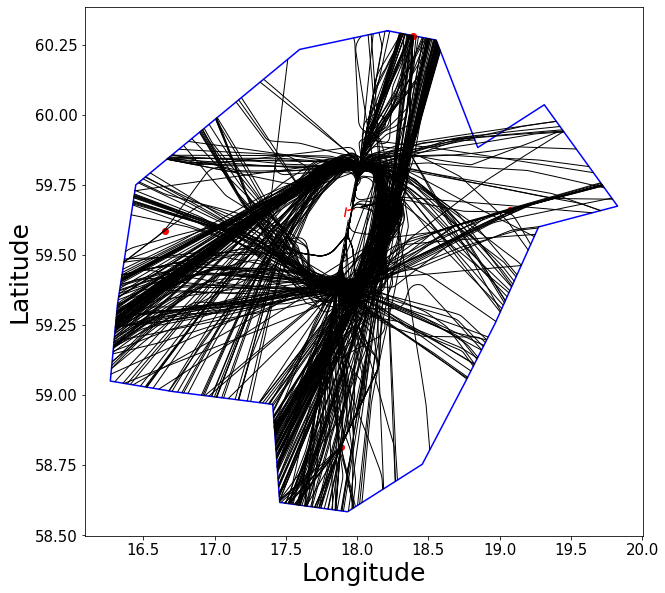

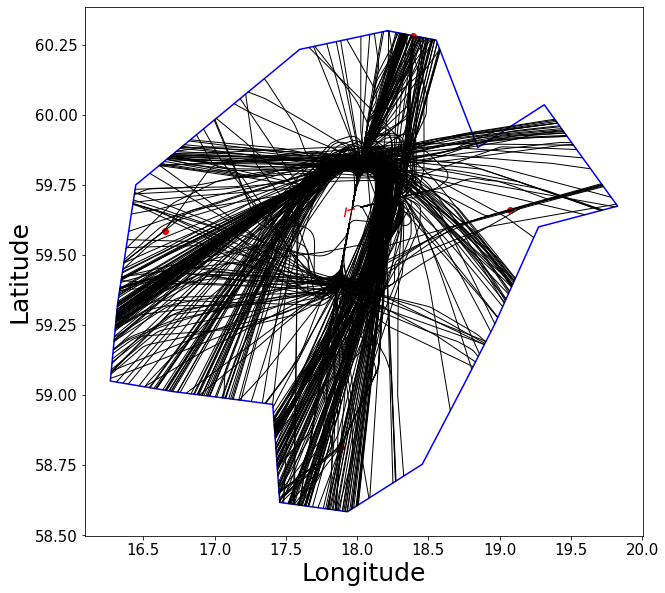

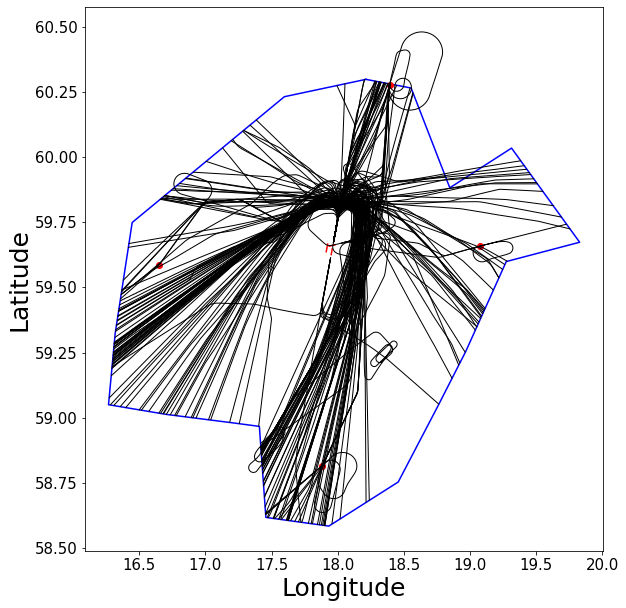

In [47]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_10_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_10_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_10_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_10_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_10_5.png")

In [48]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_11_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_11_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_11_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_11_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_11_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

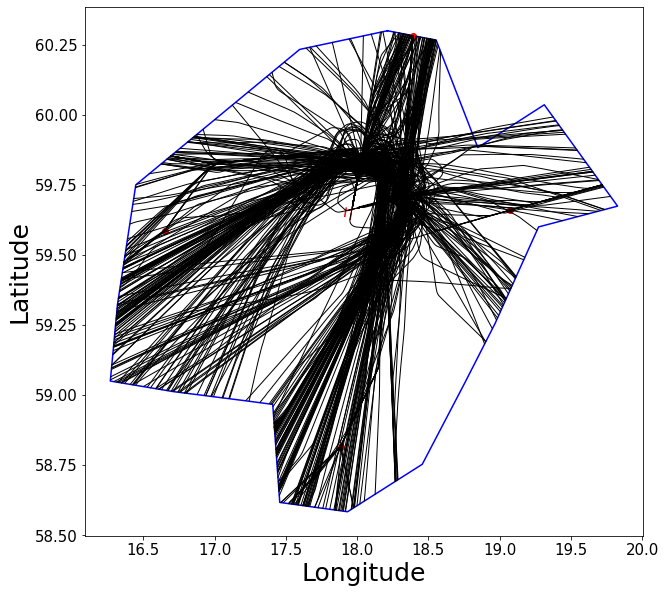

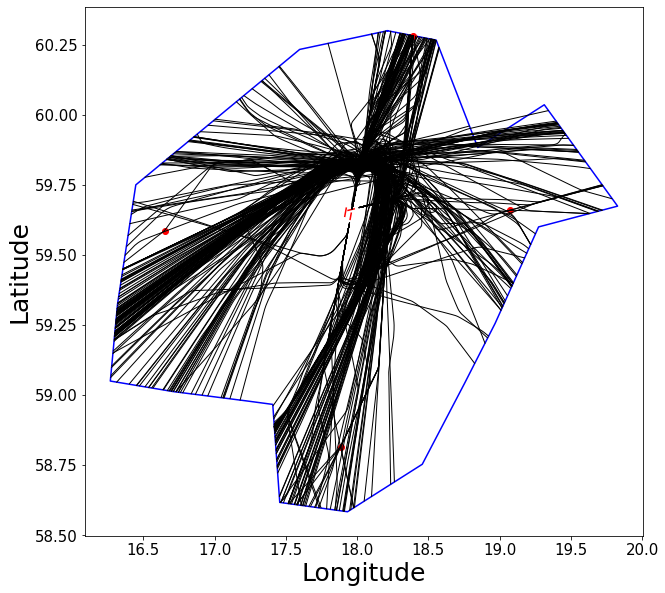

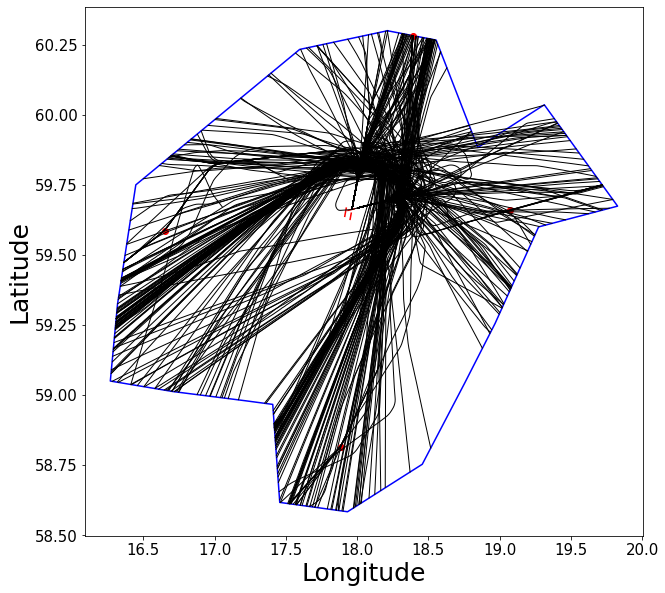

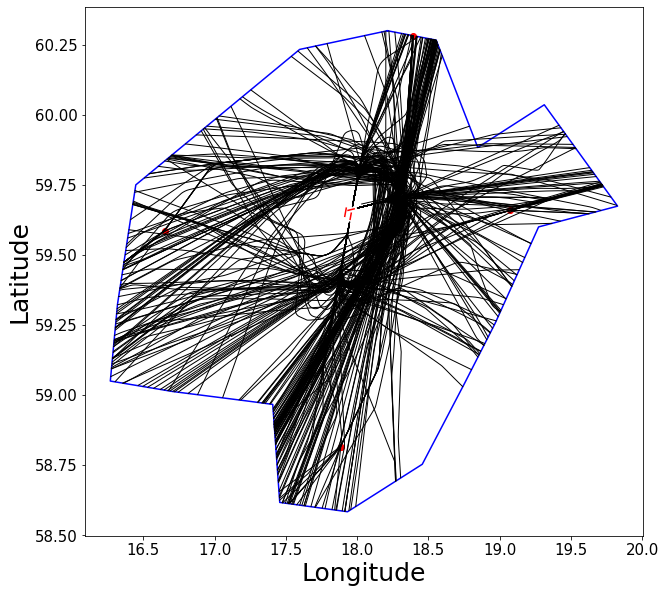

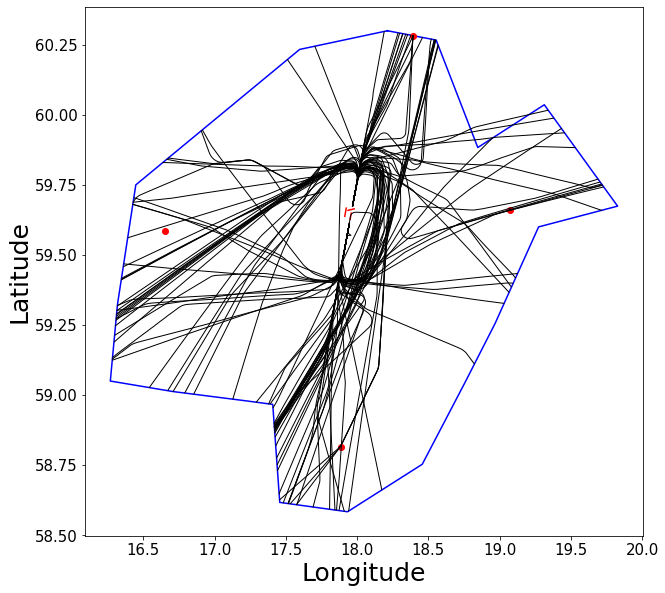

In [49]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_11_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_11_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_11_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_11_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_11_5.png")

In [50]:
filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_12_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_12_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_12_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_12_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESSA/2020/osn_ESSA_states_TMA_2020/osn_arrival_ESSA_states_TMA_2020_12_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

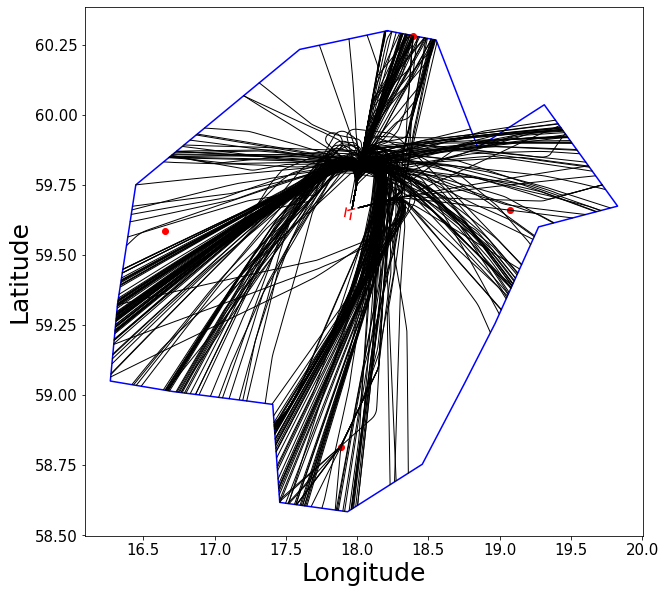

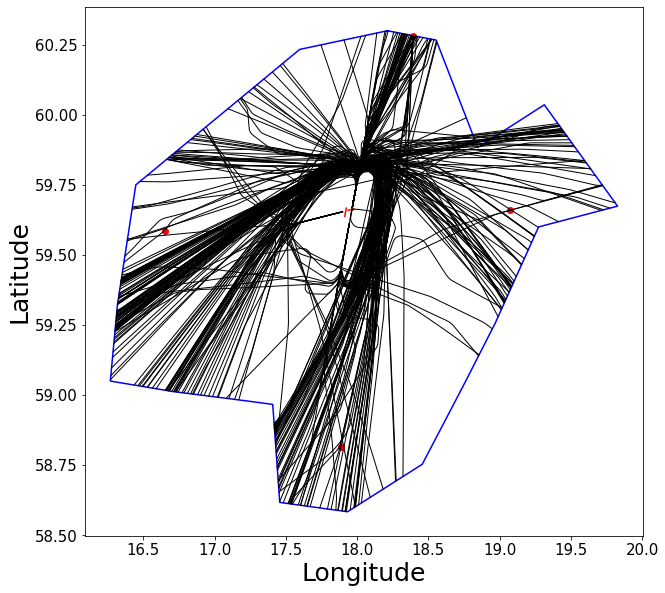

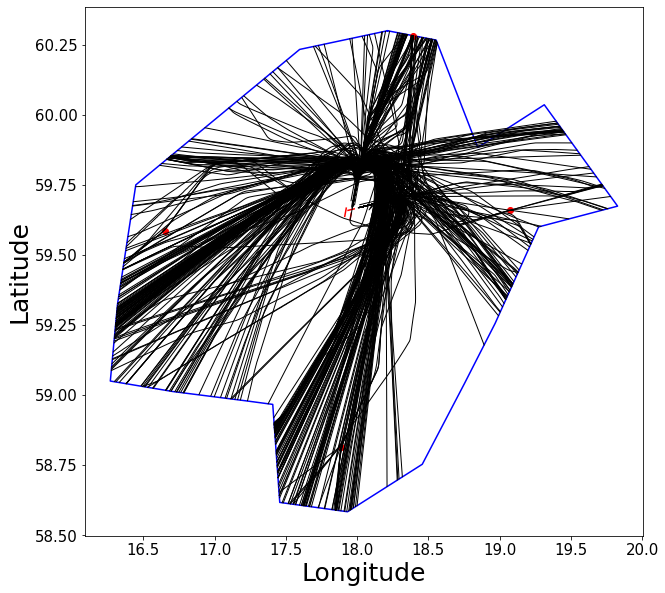

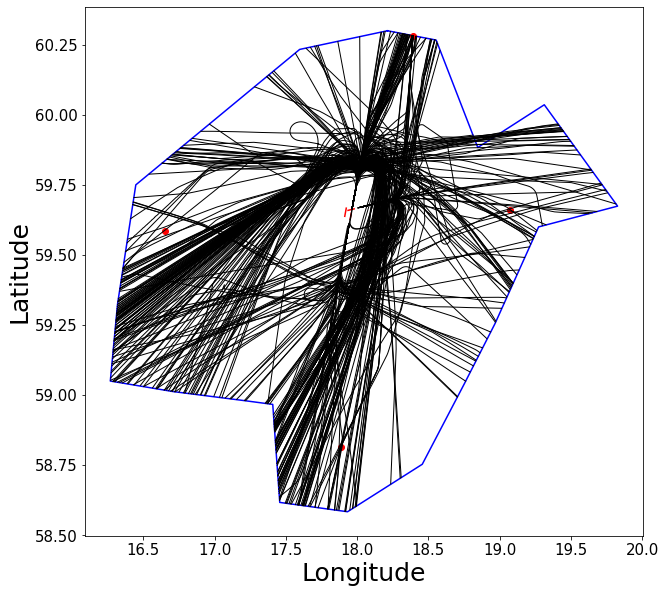

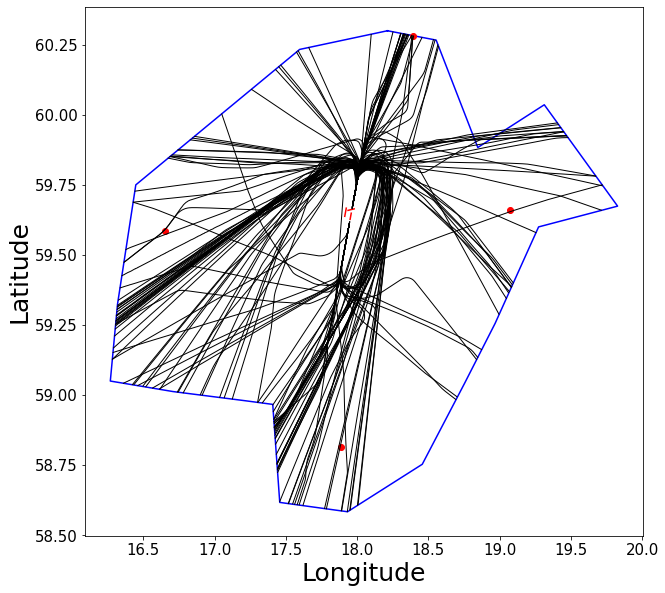

In [51]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_12_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_12_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_12_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_12_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESSA/HorizontalProfiles/ESSA_2020_12_5.png")